# U-net for parcellation
## + L-net for regression
  
  
  
    
  
- trained on cortical parcellations from Freesurfer
- finetuned on small dataset of "expert" hand-labels
- predicts output class for each pixel of input image

In [1]:
# I also like to live dangerously
import warnings
warnings.filterwarnings('ignore')

In [2]:
import unet

In [3]:
import dlutil
from dlutil.data import ToFloat
from dlutil.data import get_index_batches
from dlutil.data import BatchIndexSampler
from dlutil.utils import y_vis_sample, from_onehot

import torch
from torch.utils.data import Dataset, DataLoader

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import torchvision
import torchvision.transforms as transforms

# these are required for defining the regession ImageFolder
from typing import Dict, Any
from torchvision import datasets
from torchsummary import summary

In [4]:
import nilearn as ni
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

import os
import copy
import pickle
import collections

import numpy as np
import pandas as pd

from PIL import Image
from PIL import ImageOps
from PIL import ImagePalette

In [5]:
import nbutils
import datetime

## 1. Set up directories and process data

## 1.a HBN

In [6]:
# model directories

date = str(datetime.datetime.now().date())
model_save_dir = f'./models/model_only_curv_{date}'
os.makedirs(model_save_dir, exist_ok=True)

# data directories

base_data_dir = '/scratch/groups/jyeatman/samjohns-projects/data/atlas/sulc'
xdir = os.path.join(base_data_dir, 'xs')
ydir = os.path.join(base_data_dir, 'ys')
vdir = os.path.join(base_data_dir, 'px2v')
pdir = os.path.join(base_data_dir, 'pxcoord')

# freesurfer data directories
hbn_dir = '/oak/stanford/groups/jyeatman/HBN/BIDS_curated/derivatives/freesurfer'
hbn_surf_dir = 'surf'
hbn_parc_dir = 'label'

# data properties

in_channels = 5
out_channels = 21

In [7]:
merge_columns = ['EID', 'Angle1', 'Angle2']
filename_columns = ['Filename_x', 'Filename_y', 'Filename_v', 'Filename_p']

x_df = nbutils.get_subjects_df(xdir).rename({'Filename': filename_columns[0]}, axis=1)
y_df = nbutils.get_subjects_df(ydir).rename({'Filename': filename_columns[1]}, axis=1)
v_df = nbutils.get_subjects_df(vdir).rename({'Filename': filename_columns[2]}, axis=1)
p_df = nbutils.get_subjects_df(pdir).rename({'Filename': filename_columns[3]}, axis=1)

hbn_df = pd.merge(x_df, y_df, on=merge_columns, how='inner')
hbn_df = pd.merge(hbn_df, v_df, on=merge_columns, how='inner')
hbn_df = pd.merge(hbn_df, p_df, on=merge_columns, how='inner')

hbn_df = hbn_df[filename_columns + merge_columns]  # reorder columns
hbn_df.head()

,Filename_x,Filename_y,Filename_v,Filename_p,EID,Angle1,Angle2
0,sub-NDARLJ355VAG-218.41-82.39-curv.npy,sub-NDARLJ355VAG-218.41-82.39-parc.npy,sub-NDARLJ355VAG-218.41-82.39-px2v.pkl,sub-NDARLJ355VAG-218.41-82.39-pxcoord.npy,sub-NDARLJ355VAG,218.41,82.39
1,sub-NDARKN633WZA-201.56-87.93-curv.npy,sub-NDARKN633WZA-201.56-87.93-parc.npy,sub-NDARKN633WZA-201.56-87.93-px2v.pkl,sub-NDARKN633WZA-201.56-87.93-pxcoord.npy,sub-NDARKN633WZA,201.56,87.93
2,sub-NDARCJ330NBP-212.41-81.04-curv.npy,sub-NDARCJ330NBP-212.41-81.04-parc.npy,sub-NDARCJ330NBP-212.41-81.04-px2v.pkl,sub-NDARCJ330NBP-212.41-81.04-pxcoord.npy,sub-NDARCJ330NBP,212.41,81.04
3,sub-NDARRN598JXJ-207.12-98.81-curv.npy,sub-NDARRN598JXJ-207.12-98.81-parc.npy,sub-NDARRN598JXJ-207.12-98.81-px2v.pkl,sub-NDARRN598JXJ-207.12-98.81-pxcoord.npy,sub-NDARRN598JXJ,207.12,98.81
4,sub-NDARHB803UT9-212.04-93.64-curv.npy,sub-NDARHB803UT9-212.04-93.64-parc.npy,sub-NDARHB803UT9-212.04-93.64-px2v.pkl,sub-NDARHB803UT9-212.04-93.64-pxcoord.npy,sub-NDARHB803UT9,212.04,93.64


## 1.b OTS (FFK)

In [6]:
# model directories

date = str(datetime.datetime.now().date())
model_save_dir = f'./models/model_{date}'
os.makedirs(model_save_dir, exist_ok=True)

# data directories

base_data_dir = '/scratch/groups/jyeatman/samjohns-projects/data/atlas/ots-sulc'
xdir = os.path.join(base_data_dir, 'xs')
ydir = os.path.join(base_data_dir, 'ys')
vdir = os.path.join(base_data_dir, 'px2v')
pdir = os.path.join(base_data_dir, 'pxcoord')

# freesurfer data directories
ots_dir = '/oak/stanford/groups/jyeatman/samjohns/samjohns-projects-backup/ots-data'
ots_surf_dir = 'surf'
ots_parc_dir = 'label/manual_label'

# data properties

in_channels = 5
out_channels = 7

In [7]:
ots_parse_dict = {'EID': (lambda s: s.split('-')[0]), 
                  'Angle1': (lambda s: s.split('-')[1]), 
                  'Angle2': (lambda s: s.split('-')[2])
                 } 

In [8]:
merge_columns = ['EID', 'Angle1', 'Angle2']
filename_columns = ['Filename_x', 'Filename_y', 'Filename_v', 'Filename_p']

x_df = nbutils.get_subjects_df(xdir, extract_dict=ots_parse_dict).rename({'Filename': filename_columns[0]}, axis=1)
y_df = nbutils.get_subjects_df(ydir, extract_dict=ots_parse_dict).rename({'Filename': filename_columns[1]}, axis=1)
v_df = nbutils.get_subjects_df(vdir, extract_dict=ots_parse_dict).rename({'Filename': filename_columns[2]}, axis=1)
p_df = nbutils.get_subjects_df(pdir, extract_dict=ots_parse_dict).rename({'Filename': filename_columns[3]}, axis=1)

ots_df = pd.merge(x_df, y_df, on=merge_columns, how='inner')
ots_df = pd.merge(ots_df, v_df, on=merge_columns, how='inner')
ots_df = pd.merge(ots_df, p_df, on=merge_columns, how='inner')

ots_df = ots_df[filename_columns + merge_columns]  # reorder columns
ots_df.head()

,Filename_x,Filename_y,Filename_v,Filename_p,EID,Angle1,Angle2
0,6005_T1.long.6005-213.54-102.94-curv.npy,6005_T1.long.6005-213.54-102.94-parc.npy,6005_T1.long.6005-213.54-102.94-px2v.pkl,6005_T1.long.6005-213.54-102.94-pxcoord.npy,6005_T1.long.6005,213.54,102.94
1,5107_T1.long.5107-210.90-76.07-curv.npy,5107_T1.long.5107-210.90-76.07-parc.npy,5107_T1.long.5107-210.90-76.07-px2v.pkl,5107_T1.long.5107-210.90-76.07-pxcoord.npy,5107_T1.long.5107,210.90,76.07
2,6101_T1.long.6101-208.64-79.78-curv.npy,6101_T1.long.6101-208.64-79.78-parc.npy,6101_T1.long.6101-208.64-79.78-px2v.pkl,6101_T1.long.6101-208.64-79.78-pxcoord.npy,6101_T1.long.6101,208.64,79.78
3,6120_T1.long.6120-220.11-83.50-curv.npy,6120_T1.long.6120-220.11-83.50-parc.npy,6120_T1.long.6120-220.11-83.50-px2v.pkl,6120_T1.long.6120-220.11-83.50-pxcoord.npy,6120_T1.long.6120,220.11,83.50
4,6120_T1.long.6120-202.88-82.72-curv.npy,6120_T1.long.6120-202.88-82.72-parc.npy,6120_T1.long.6120-202.88-82.72-px2v.pkl,6120_T1.long.6120-202.88-82.72-pxcoord.npy,6120_T1.long.6120,202.88,82.72


## 1.0 Create test-train split respecting subject EIDs

In [8]:
eids = list(x_df['EID'].unique())

NameError: name 'x_df' is not defined

In [ ]:
ntotal = len(eids)
ntest = ntotal // 4
ntrain = ntotal - ntest
test_eids = np.random.choice(eids, size=ntest, replace=False)
train_eids = list(set(eids) - set(test_eids))

In [ ]:
len(test_eids), len(train_eids), len(eids)

In [10]:
ots_df['Train'] = ots_df['EID'].apply(lambda s: s in train_eids)
ots_df.head()

NameError: name 'ots_df' is not defined

In [9]:
# save mapping file for dataset construction
# with train / test split
# load previous files if they exist

save_not_load = False

# filepaths
data_prefix = 'ots'
# data_prefix = 'hbn'
# data_df = ots_df

trn_csv_fpath = f'{base_data_dir}/{data_prefix}_sulc_mapping_trn.csv'
val_csv_fpath = f'{base_data_dir}/{data_prefix}_sulc_mapping_val.csv'
    
# save or load
if save_not_load:

    data_df[data_df['Train']==True].to_csv(trn_csv_fpath, index=False)
    data_df[data_df['Train']==False].to_csv(val_csv_fpath, index=False)
    
else:
    
    trn_df = pd.read_csv(trn_csv_fpath)
    val_df = pd.read_csv(val_csv_fpath)
    
    trn_df['Train'] = True
    val_df['Train'] = False
    data_df = pd.concat([trn_df, val_df])

In [10]:
ots_df = data_df
ots_df.head()

,Filename_x,Filename_y,Filename_v,Filename_p,EID,Angle1,Angle2,Train
0,6005_T1.long.6005-213.54-102.94-curv.npy,6005_T1.long.6005-213.54-102.94-parc.npy,6005_T1.long.6005-213.54-102.94-px2v.pkl,6005_T1.long.6005-213.54-102.94-pxcoord.npy,6005_T1.long.6005,213.54,102.94,True
1,5107_T1.long.5107-210.90-76.07-curv.npy,5107_T1.long.5107-210.90-76.07-parc.npy,5107_T1.long.5107-210.90-76.07-px2v.pkl,5107_T1.long.5107-210.90-76.07-pxcoord.npy,5107_T1.long.5107,210.90,76.07,True
2,6120_T1.long.6120-220.11-83.50-curv.npy,6120_T1.long.6120-220.11-83.50-parc.npy,6120_T1.long.6120-220.11-83.50-px2v.pkl,6120_T1.long.6120-220.11-83.50-pxcoord.npy,6120_T1.long.6120,220.11,83.50,True
3,6120_T1.long.6120-202.88-82.72-curv.npy,6120_T1.long.6120-202.88-82.72-parc.npy,6120_T1.long.6120-202.88-82.72-px2v.pkl,6120_T1.long.6120-202.88-82.72-pxcoord.npy,6120_T1.long.6120,202.88,82.72,True
4,5108_T1.long.5108-216.15-97.47-curv.npy,5108_T1.long.5108-216.15-97.47-parc.npy,5108_T1.long.5108-216.15-97.47-px2v.pkl,5108_T1.long.5108-216.15-97.47-pxcoord.npy,5108_T1.long.5108,216.15,97.47,True


## 1.1 Create datasets

In [11]:
from dlutil.data import aggregate_classes, _make_agg_matrix

n_orig_classes = out_channels
fg_agg_dict = {0: [0], 1: list(range(1, out_channels))}
n_agg_classes = len(fg_agg_dict)

null_agg_dict = {i: [i] for i in range(n_orig_classes)}
ots_agg_dict = {0: [0], 1: [1], 2: [2, 3, 4, 5, 6]}
# keep_channels = [0, 2, 3]

In [12]:
trf = transforms.Compose([transforms.ToTensor(), 
                          dlutil.data.ToFloat()])
target_trf = transforms.Compose([transforms.ToTensor(), 
                                 dlutil.data.ToLong()])

In [13]:
ds_trn = dlutil.data.CustomUnetDataset(xdir=xdir, ydir=ydir,
                                       mapping_file=trn_csv_fpath,
                                       transform=trf,
                                       target_transform=target_trf, 
                                       nclasses=out_channels,
                                       agg_dict=ots_agg_dict, 
                                       # keep_channels=keep_channels
                                      )

ds_val = dlutil.data.CustomUnetDataset(xdir=xdir, ydir=ydir,
                                       mapping_file=val_csv_fpath,
                                       transform=trf,
                                       target_transform=target_trf, 
                                       nclasses=out_channels,
                                       agg_dict=ots_agg_dict,
                                       # keep_channels=keep_channels
                                      )

In [14]:
len(ds_trn), len(ds_val)

(1090, 375)

In [15]:
# create dataloaders

bs = 32
nw = 3  # number of cpu's to use to parallelize dl
pm = True  # whether to pin memory in dl

dl_train = DataLoader(ds_trn, batch_size=bs, shuffle=True, pin_memory=pm)
dl_test = DataLoader(ds_val, batch_size=bs, shuffle=False, pin_memory=pm)

In [16]:
# create subject-group dataloader for val set

df_val = ds_val.xy_pairs
gp_ind = get_index_batches(df_val, group_name='EID')
s_bind = BatchIndexSampler(gp_ind)

dl_val_eid_batches = DataLoader(ds_val, batch_sampler=s_bind)
di_val_eid_batches = iter(dl_val_eid_batches)

## 1.2 Visualize arrays

In [17]:
di_test = iter(dl_test)
xte, yte = next(di_test)

In [18]:
xte.shape, yte.shape, xte.dtype, yte.dtype

(torch.Size([32, 5, 256, 256]),
 torch.Size([32, 3, 256, 256]),
 torch.float32,
 torch.float32)

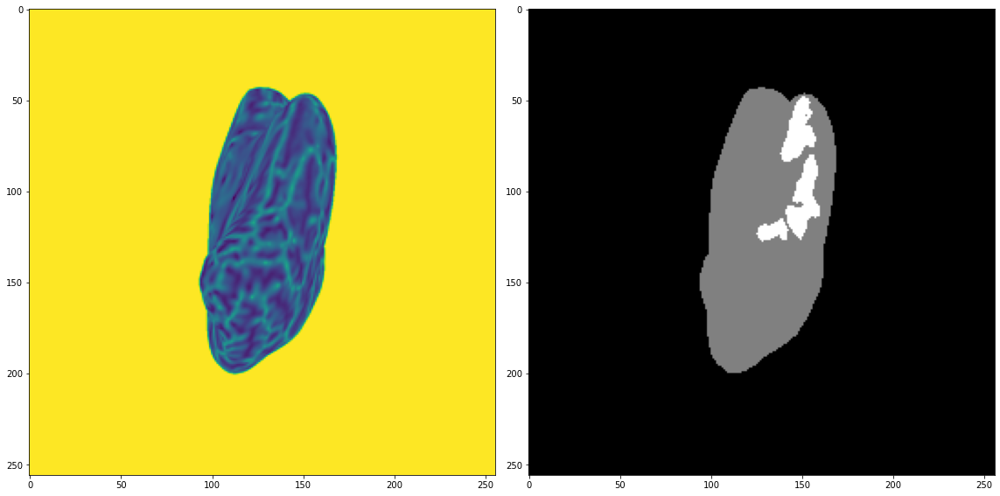

In [19]:
i_sample = 0
i_channel = 0

fig, ax = plt.subplots(1, 2, figsize=(16, 8))
ax[0].imshow(xte[i_sample, i_channel])
ax[1].imshow(yte.argmax(dim=1)[i_sample], cmap='gray') # cmap='tab20'
plt.tight_layout()

## 2. Define Unet and train

In [20]:
xtr, ytr = next(iter(dl_train))
xte, yte = next(iter(dl_test))

in_channels = xte.shape[1]
out_channels_agg = yte.shape[1]
xtr.shape, ytr.shape, xte.shape, yte.shape

(torch.Size([32, 5, 256, 256]),
 torch.Size([32, 3, 256, 256]),
 torch.Size([32, 5, 256, 256]),
 torch.Size([32, 3, 256, 256]))

In [21]:
model = unet.UNet(feature_count=in_channels, class_count=out_channels_agg, apply_sigmoid=False)
device = dlutil.utils.get_device()
device

device(type='cuda', index=0)

In [22]:
model.to(device)

UNet(
  (base_model): ResNet(
    (conv1): Conv2d(5, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_run

In [26]:
summary(model, (5, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 64, 256, 256]        --
|    └─Conv2d: 2-1                       [-1, 64, 256, 256]        2,944
|    └─ReLU: 2-2                         [-1, 64, 256, 256]        --
├─Sequential: 1-2                        [-1, 64, 256, 256]        --
|    └─Conv2d: 2-3                       [-1, 64, 256, 256]        36,928
|    └─ReLU: 2-4                         [-1, 64, 256, 256]        --
├─Sequential: 1-3                        [-1, 64, 128, 128]        --
├─ResNet: 1                              []                        --
|    └─Conv2d: 2-5                       [-1, 64, 128, 128]        15,680
├─Sequential: 1                          []                        --
|    └─Conv2d: 2-6                       [-1, 64, 128, 128]        (recursive)
├─ResNet: 1                              []                        --
|    └─BatchNorm2d: 2-7                  [-1, 64, 128, 128]      

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 64, 256, 256]        --
|    └─Conv2d: 2-1                       [-1, 64, 256, 256]        2,944
|    └─ReLU: 2-2                         [-1, 64, 256, 256]        --
├─Sequential: 1-2                        [-1, 64, 256, 256]        --
|    └─Conv2d: 2-3                       [-1, 64, 256, 256]        36,928
|    └─ReLU: 2-4                         [-1, 64, 256, 256]        --
├─Sequential: 1-3                        [-1, 64, 128, 128]        --
├─ResNet: 1                              []                        --
|    └─Conv2d: 2-5                       [-1, 64, 128, 128]        15,680
├─Sequential: 1                          []                        --
|    └─Conv2d: 2-6                       [-1, 64, 128, 128]        (recursive)
├─ResNet: 1                              []                        --
|    └─BatchNorm2d: 2-7                  [-1, 64, 128, 128]      

In [23]:
def get_last_fns(model_load_dir, return_optim=True):
    """ Selects the latest model and load files
        from a given directory, returning them
        as a tuple of filenames.
    """
    import os
    fns = os.listdir(model_load_dir)
    opt = []
    if return_optim:
        opt = sorted([fn for fn in fns if 'optim' in fn])[-1]
    mod = sorted([fn for fn in fns if 'model' in fn])[-1] 
    return mod, opt

In [43]:
reload_parameters = True
cpu = (device.type == 'cpu') 
device_string = 'cuda' if not cpu else 'cpu'  # in case model is saved from GPU but reloaded to CPU

if reload_parameters:
    
    model_load_dir = './models/model_2022-10-12'
    # model_load_dir = model_save_dir
    model_state_fn, optim_state_fn = get_last_fns(model_load_dir)

    # reload model state dict
    with open(f'{model_load_dir}/{model_state_fn}', 'rb') as f:
        model_reload_dict = torch.load(f, map_location=torch.device(device_string))

    # reload optimizer state dict
    with open(f'{model_load_dir}/{optim_state_fn}', 'rb') as f:
        optim_reload_dict = torch.load(f, map_location=torch.device(device_string))

In [44]:
discard_keywords = ['conv_last', 'conv_original', 'conv_up']

In [47]:
discard_keys

['conv_last.weight',
 'conv_last.bias',
 'conv_original_size0.0.weight',
 'conv_original_size0.0.bias',
 'conv_original_size1.0.weight',
 'conv_original_size1.0.bias',
 'conv_original_size2.0.weight',
 'conv_original_size2.0.bias',
 'conv_up3.0.weight',
 'conv_up3.0.bias',
 'conv_up2.0.weight',
 'conv_up2.0.bias',
 'conv_up1.0.weight',
 'conv_up1.0.bias',
 'conv_up0.0.weight',
 'conv_up0.0.bias']

In [46]:
pretrained_params = model_reload_dict
discard_keys = []
for kw in discard_keywords:
    discard_keys += [k for k in list(pretrained_params.keys()) if kw in k]

for k in discard_keys:
    pretrained_params.pop(k, None)

discard_keys, discard_keys[0] in pretrained_params.keys(), discard_keys[1] in pretrained_params.keys()

(['conv_last.weight',
  'conv_last.bias',
  'conv_original_size0.0.weight',
  'conv_original_size0.0.bias',
  'conv_original_size1.0.weight',
  'conv_original_size1.0.bias',
  'conv_original_size2.0.weight',
  'conv_original_size2.0.bias',
  'conv_up3.0.weight',
  'conv_up3.0.bias',
  'conv_up2.0.weight',
  'conv_up2.0.bias',
  'conv_up1.0.weight',
  'conv_up1.0.bias',
  'conv_up0.0.weight',
  'conv_up0.0.bias'],
 False,
 False)

In [48]:
def make_pretrained_state_dict(model_state, pretrained_state):
    pd = pretrained_state
    sd = model_state
    warmstart_params = copy.deepcopy(sd)
    for k, v in pd.items():
        warmstart_params[k] = v
    return warmstart_params

warmstart_params = make_pretrained_state_dict(model.state_dict(), pretrained_params)
model.load_state_dict(warmstart_params)

<All keys matched successfully>

In [54]:
model_save_dir = f'./models/model_ots_fixed_inputs_unfreeze_last_3_finetune_0.0bce_{date}'

In [55]:
os.makedirs(model_save_dir, exist_ok=True)

In [56]:
# freeze all but the last layer
dlutil.utils.set_unfreeze_(model, [model.conv_last, 
                                   model.conv_original_size0, 
                                   model.conv_original_size1, 
                                   model.conv_original_size2,
                                   model.conv_up0,
                                   model.conv_up1,
                                   model.conv_up2,
                                   model.conv_up3
                                  ])

# confirm correct freeze / unfreeze
dlutil.utils.check_requires_grad(model.conv_last), \
dlutil.utils.check_requires_grad(model.conv_original_size0), \
dlutil.utils.check_requires_grad(model.conv_up3)

(True, True, True)

In [57]:
# data dictionaries formatted for input to training loop
dl_dict = {'trn': dl_train, 'val': dl_test}

# training proceeds along this plan
# shifts weight from bcd to dice
training_plan = [
    dict(lr=0.00375, gamma=0.9, num_batches=int(1e4),  bce_weight=0.67),
    dict(lr=0.00250, gamma=0.9, num_batches=int(1e4),  bce_weight=0.33),
    dict(lr=0.00125, gamma=0.9, num_batches=int(1e4),  bce_weight=0.00)
]

training_plan_short = [dict(lr=0.00375, gamma=0.9, num_batches=int(1e5),  bce_weight=0.00)]

In [ ]:
train = True
reload_optimizer_state = False

if train:
    
    tp = training_plan_short  # abbreviated for testing
    for e, t in enumerate(tp):

        # get hyperparameters
        lr = t['lr']
        gamma = t['gamma']
        bce_weight = t['bce_weight']
        num_batches = t['num_batches']

        # define training objects
        optimizer = torch.optim.Adam(
            filter(lambda p: p.requires_grad, model.parameters()), lr=lr)

        # initialize optimizer
        if reload_optimizer_state and (e == 0):
            optimizer.load_state_dict(optim_reload_dict)

        # other parameters
        step_size = len(dl_dict['trn']) 
        scheduler = torch.optim.lr_scheduler.StepLR(
            optimizer,
            step_size=step_size,
            gamma=gamma)

        # train loop
        result = unet.train.train_model(model, 
                                        optimizer, 
                                        scheduler, 
                                        dl_dict, 
                                        save_path=model_save_dir, 
                                        report_every=5, 
                                        checkpoint_every=100, 
                                        logits=True, 
                                        num_batches=num_batches, 
                                        logger=None)
        model, best_dice, best_bce, losses = result

Train loss: 0.04059; Val loss: 0.30737; Val bce: 0.26825; Val dice: 0.34649
Train loss: 0.07192; Val loss: 0.12527; Val bce: 0.06952; Val dice: 0.18103
Train loss: 0.07851; Val loss: 0.10369; Val bce: 0.06454; Val dice: 0.14284
Train loss: 0.06112; Val loss: 0.09264; Val bce: 0.05222; Val dice: 0.13307
Train loss: 0.06175; Val loss: 0.09938; Val bce: 0.05309; Val dice: 0.14567
Train loss: 0.05473; Val loss: 0.08699; Val bce: 0.04326; Val dice: 0.13072
Train loss: 0.05277; Val loss: 0.09256; Val bce: 0.04691; Val dice: 0.13821
Train loss: 0.05291; Val loss: 0.08777; Val bce: 0.04772; Val dice: 0.12783
Train loss: 0.04978; Val loss: 0.08845; Val bce: 0.04505; Val dice: 0.13185
Train loss: 0.05150; Val loss: 0.07732; Val bce: 0.04195; Val dice: 0.11270
Train loss: 0.04805; Val loss: 0.07462; Val bce: 0.03886; Val dice: 0.11038
Train loss: 0.05046; Val loss: 0.07791; Val bce: 0.04063; Val dice: 0.11518
Train loss: 0.04838; Val loss: 0.07597; Val bce: 0.04007; Val dice: 0.11187
Train loss: 

Train loss: 0.03645; Val loss: 0.07590; Val bce: 0.04170; Val dice: 0.11009
Train loss: 0.03459; Val loss: 0.07610; Val bce: 0.04166; Val dice: 0.11054
Train loss: 0.03531; Val loss: 0.07424; Val bce: 0.04117; Val dice: 0.10730
Train loss: 0.04044; Val loss: 0.07544; Val bce: 0.04138; Val dice: 0.10951
Train loss: 0.03455; Val loss: 0.07527; Val bce: 0.04148; Val dice: 0.10905
Train loss: 0.03654; Val loss: 0.07512; Val bce: 0.04146; Val dice: 0.10877
Train loss: 0.03631; Val loss: 0.07513; Val bce: 0.04143; Val dice: 0.10883
Train loss: 0.03918; Val loss: 0.07508; Val bce: 0.04151; Val dice: 0.10864
Train loss: 0.03588; Val loss: 0.07561; Val bce: 0.04155; Val dice: 0.10968
Train loss: 0.03741; Val loss: 0.07646; Val bce: 0.04183; Val dice: 0.11110
Train loss: 0.03859; Val loss: 0.07504; Val bce: 0.04174; Val dice: 0.10834
Train loss: 0.03413; Val loss: 0.07596; Val bce: 0.04173; Val dice: 0.11019
Train loss: 0.03555; Val loss: 0.07575; Val bce: 0.04180; Val dice: 0.10969
Train loss: 

Train loss: 0.03492; Val loss: 0.07630; Val bce: 0.04262; Val dice: 0.10998
Train loss: 0.03367; Val loss: 0.07565; Val bce: 0.04242; Val dice: 0.10887
Train loss: 0.03395; Val loss: 0.07680; Val bce: 0.04265; Val dice: 0.11096
Train loss: 0.03245; Val loss: 0.07657; Val bce: 0.04269; Val dice: 0.11045
Train loss: 0.03330; Val loss: 0.07534; Val bce: 0.04229; Val dice: 0.10838
Train loss: 0.03301; Val loss: 0.07589; Val bce: 0.04237; Val dice: 0.10940
Train loss: 0.03319; Val loss: 0.07579; Val bce: 0.04235; Val dice: 0.10922
Train loss: 0.03549; Val loss: 0.07558; Val bce: 0.04223; Val dice: 0.10894
Train loss: 0.03477; Val loss: 0.07697; Val bce: 0.04272; Val dice: 0.11123
Train loss: 0.03207; Val loss: 0.07553; Val bce: 0.04225; Val dice: 0.10881
Train loss: 0.03371; Val loss: 0.07581; Val bce: 0.04226; Val dice: 0.10936
Train loss: 0.03313; Val loss: 0.07626; Val bce: 0.04252; Val dice: 0.11000
Train loss: 0.03587; Val loss: 0.07549; Val bce: 0.04227; Val dice: 0.10871
Train loss: 

Train loss: 0.03286; Val loss: 0.07661; Val bce: 0.04279; Val dice: 0.11043
Train loss: 0.03652; Val loss: 0.07654; Val bce: 0.04272; Val dice: 0.11037
Train loss: 0.03496; Val loss: 0.07664; Val bce: 0.04278; Val dice: 0.11050
Train loss: 0.03426; Val loss: 0.07650; Val bce: 0.04272; Val dice: 0.11027
Train loss: 0.03258; Val loss: 0.07644; Val bce: 0.04268; Val dice: 0.11020
Train loss: 0.03368; Val loss: 0.07642; Val bce: 0.04272; Val dice: 0.11011
Train loss: 0.03465; Val loss: 0.07651; Val bce: 0.04280; Val dice: 0.11022
Train loss: 0.03507; Val loss: 0.07638; Val bce: 0.04279; Val dice: 0.10997
Train loss: 0.03489; Val loss: 0.07624; Val bce: 0.04274; Val dice: 0.10975
Train loss: 0.03351; Val loss: 0.07612; Val bce: 0.04275; Val dice: 0.10949
Train loss: 0.03192; Val loss: 0.07622; Val bce: 0.04278; Val dice: 0.10966
Train loss: 0.03236; Val loss: 0.07628; Val bce: 0.04276; Val dice: 0.10980
Train loss: 0.03302; Val loss: 0.07614; Val bce: 0.04275; Val dice: 0.10952
Train loss: 

Train loss: 0.03194; Val loss: 0.07616; Val bce: 0.04267; Val dice: 0.10965
Train loss: 0.03526; Val loss: 0.07607; Val bce: 0.04265; Val dice: 0.10949
Train loss: 0.03176; Val loss: 0.07615; Val bce: 0.04274; Val dice: 0.10956
Train loss: 0.03044; Val loss: 0.07614; Val bce: 0.04274; Val dice: 0.10955
Train loss: 0.03271; Val loss: 0.07609; Val bce: 0.04268; Val dice: 0.10950
Train loss: 0.03051; Val loss: 0.07619; Val bce: 0.04268; Val dice: 0.10969
Train loss: 0.03751; Val loss: 0.07636; Val bce: 0.04275; Val dice: 0.10997
Train loss: 0.03459; Val loss: 0.07641; Val bce: 0.04273; Val dice: 0.11009
Train loss: 0.03322; Val loss: 0.07637; Val bce: 0.04266; Val dice: 0.11008
Train loss: 0.03200; Val loss: 0.07662; Val bce: 0.04285; Val dice: 0.11040
Train loss: 0.03588; Val loss: 0.07656; Val bce: 0.04283; Val dice: 0.11030
Train loss: 0.03788; Val loss: 0.07649; Val bce: 0.04275; Val dice: 0.11023
Train loss: 0.03212; Val loss: 0.07641; Val bce: 0.04267; Val dice: 0.11014
Train loss: 

Train loss: 0.03365; Val loss: 0.07639; Val bce: 0.04279; Val dice: 0.10999
Train loss: 0.03275; Val loss: 0.07648; Val bce: 0.04287; Val dice: 0.11009
Train loss: 0.03772; Val loss: 0.07653; Val bce: 0.04292; Val dice: 0.11014
Train loss: 0.03371; Val loss: 0.07635; Val bce: 0.04275; Val dice: 0.10996
Train loss: 0.03059; Val loss: 0.07651; Val bce: 0.04285; Val dice: 0.11018
Train loss: 0.03336; Val loss: 0.07662; Val bce: 0.04293; Val dice: 0.11032
Train loss: 0.03396; Val loss: 0.07659; Val bce: 0.04289; Val dice: 0.11028
Train loss: 0.03314; Val loss: 0.07654; Val bce: 0.04285; Val dice: 0.11023
Train loss: 0.03398; Val loss: 0.07645; Val bce: 0.04281; Val dice: 0.11010
Train loss: 0.03305; Val loss: 0.07639; Val bce: 0.04277; Val dice: 0.11001
Train loss: 0.03100; Val loss: 0.07647; Val bce: 0.04283; Val dice: 0.11012
Train loss: 0.03367; Val loss: 0.07640; Val bce: 0.04277; Val dice: 0.11002
Train loss: 0.03459; Val loss: 0.07633; Val bce: 0.04273; Val dice: 0.10993
Train loss: 

Train loss: 0.03227; Val loss: 0.07652; Val bce: 0.04280; Val dice: 0.11023
Train loss: 0.03302; Val loss: 0.07660; Val bce: 0.04286; Val dice: 0.11033
Train loss: 0.03291; Val loss: 0.07647; Val bce: 0.04278; Val dice: 0.11016
Train loss: 0.02995; Val loss: 0.07646; Val bce: 0.04275; Val dice: 0.11016
Train loss: 0.03076; Val loss: 0.07652; Val bce: 0.04281; Val dice: 0.11024
Train loss: 0.03194; Val loss: 0.07653; Val bce: 0.04282; Val dice: 0.11024
Train loss: 0.03674; Val loss: 0.07648; Val bce: 0.04275; Val dice: 0.11020
Train loss: 0.03464; Val loss: 0.07659; Val bce: 0.04280; Val dice: 0.11038
Train loss: 0.03037; Val loss: 0.07664; Val bce: 0.04291; Val dice: 0.11038
Train loss: 0.03255; Val loss: 0.07646; Val bce: 0.04278; Val dice: 0.11013
Train loss: 0.03249; Val loss: 0.07635; Val bce: 0.04269; Val dice: 0.11000
Train loss: 0.03501; Val loss: 0.07632; Val bce: 0.04269; Val dice: 0.10996
Train loss: 0.03333; Val loss: 0.07643; Val bce: 0.04272; Val dice: 0.11014
Train loss: 

Train loss: 0.03609; Val loss: 0.07641; Val bce: 0.04280; Val dice: 0.11001
Train loss: 0.03407; Val loss: 0.07650; Val bce: 0.04285; Val dice: 0.11015
Train loss: 0.03311; Val loss: 0.07651; Val bce: 0.04286; Val dice: 0.11016
Train loss: 0.03265; Val loss: 0.07643; Val bce: 0.04277; Val dice: 0.11010
Train loss: 0.03459; Val loss: 0.07645; Val bce: 0.04275; Val dice: 0.11015
Train loss: 0.03045; Val loss: 0.07640; Val bce: 0.04276; Val dice: 0.11004
Train loss: 0.03754; Val loss: 0.07638; Val bce: 0.04274; Val dice: 0.11001
Train loss: 0.03671; Val loss: 0.07648; Val bce: 0.04278; Val dice: 0.11018
Train loss: 0.03434; Val loss: 0.07654; Val bce: 0.04281; Val dice: 0.11026
Train loss: 0.03234; Val loss: 0.07645; Val bce: 0.04276; Val dice: 0.11014
Train loss: 0.03266; Val loss: 0.07656; Val bce: 0.04286; Val dice: 0.11026
Train loss: 0.03660; Val loss: 0.07648; Val bce: 0.04283; Val dice: 0.11013
Train loss: 0.03275; Val loss: 0.07638; Val bce: 0.04277; Val dice: 0.10998
Train loss: 

Train loss: 0.03411; Val loss: 0.07639; Val bce: 0.04274; Val dice: 0.11005
Train loss: 0.03571; Val loss: 0.07640; Val bce: 0.04274; Val dice: 0.11005
Train loss: 0.03146; Val loss: 0.07630; Val bce: 0.04264; Val dice: 0.10997
Train loss: 0.03486; Val loss: 0.07638; Val bce: 0.04272; Val dice: 0.11004
Train loss: 0.03088; Val loss: 0.07637; Val bce: 0.04270; Val dice: 0.11004
Train loss: 0.02955; Val loss: 0.07650; Val bce: 0.04279; Val dice: 0.11022
Train loss: 0.03610; Val loss: 0.07653; Val bce: 0.04284; Val dice: 0.11023
Train loss: 0.03403; Val loss: 0.07647; Val bce: 0.04282; Val dice: 0.11012
Train loss: 0.03315; Val loss: 0.07649; Val bce: 0.04286; Val dice: 0.11011
Train loss: 0.03477; Val loss: 0.07639; Val bce: 0.04275; Val dice: 0.11003
Train loss: 0.03581; Val loss: 0.07638; Val bce: 0.04276; Val dice: 0.10999
Train loss: 0.03277; Val loss: 0.07642; Val bce: 0.04278; Val dice: 0.11007
Train loss: 0.03196; Val loss: 0.07640; Val bce: 0.04274; Val dice: 0.11007
Train loss: 

Train loss: 0.03549; Val loss: 0.07631; Val bce: 0.04271; Val dice: 0.10991
Train loss: 0.03463; Val loss: 0.07644; Val bce: 0.04274; Val dice: 0.11015
Train loss: 0.03492; Val loss: 0.07636; Val bce: 0.04266; Val dice: 0.11006
Train loss: 0.03217; Val loss: 0.07642; Val bce: 0.04269; Val dice: 0.11014
Train loss: 0.03368; Val loss: 0.07629; Val bce: 0.04263; Val dice: 0.10995
Train loss: 0.03072; Val loss: 0.07641; Val bce: 0.04274; Val dice: 0.11008
Train loss: 0.03286; Val loss: 0.07639; Val bce: 0.04272; Val dice: 0.11006
Train loss: 0.03516; Val loss: 0.07640; Val bce: 0.04278; Val dice: 0.11003
Train loss: 0.03362; Val loss: 0.07638; Val bce: 0.04274; Val dice: 0.11002
Train loss: 0.03117; Val loss: 0.07638; Val bce: 0.04270; Val dice: 0.11007
Train loss: 0.03586; Val loss: 0.07640; Val bce: 0.04269; Val dice: 0.11011
Train loss: 0.03220; Val loss: 0.07655; Val bce: 0.04285; Val dice: 0.11025
Train loss: 0.03242; Val loss: 0.07647; Val bce: 0.04278; Val dice: 0.11016
Train loss: 

Train loss: 0.03337; Val loss: 0.07637; Val bce: 0.04272; Val dice: 0.11003
Train loss: 0.03227; Val loss: 0.07638; Val bce: 0.04270; Val dice: 0.11005
Train loss: 0.03410; Val loss: 0.07647; Val bce: 0.04278; Val dice: 0.11016
Train loss: 0.03588; Val loss: 0.07636; Val bce: 0.04271; Val dice: 0.11001
Train loss: 0.03553; Val loss: 0.07658; Val bce: 0.04294; Val dice: 0.11023
Train loss: 0.03626; Val loss: 0.07642; Val bce: 0.04279; Val dice: 0.11006
Train loss: 0.03558; Val loss: 0.07655; Val bce: 0.04285; Val dice: 0.11025
Train loss: 0.03303; Val loss: 0.07669; Val bce: 0.04296; Val dice: 0.11043
Train loss: 0.02887; Val loss: 0.07663; Val bce: 0.04293; Val dice: 0.11033
Train loss: 0.03064; Val loss: 0.07654; Val bce: 0.04290; Val dice: 0.11018
Train loss: 0.03523; Val loss: 0.07652; Val bce: 0.04285; Val dice: 0.11019
Train loss: 0.03370; Val loss: 0.07642; Val bce: 0.04279; Val dice: 0.11005
Train loss: 0.03275; Val loss: 0.07643; Val bce: 0.04275; Val dice: 0.11010
Train loss: 

Train loss: 0.03671; Val loss: 0.07649; Val bce: 0.04277; Val dice: 0.11022
Train loss: 0.03242; Val loss: 0.07647; Val bce: 0.04277; Val dice: 0.11016
Train loss: 0.03828; Val loss: 0.07641; Val bce: 0.04275; Val dice: 0.11007
Train loss: 0.03710; Val loss: 0.07638; Val bce: 0.04276; Val dice: 0.10999
Train loss: 0.03193; Val loss: 0.07642; Val bce: 0.04277; Val dice: 0.11006
Train loss: 0.03606; Val loss: 0.07635; Val bce: 0.04272; Val dice: 0.10998
Train loss: 0.03568; Val loss: 0.07634; Val bce: 0.04270; Val dice: 0.10999
Train loss: 0.02959; Val loss: 0.07639; Val bce: 0.04278; Val dice: 0.11000
Train loss: 0.02991; Val loss: 0.07643; Val bce: 0.04280; Val dice: 0.11006
Train loss: 0.03173; Val loss: 0.07629; Val bce: 0.04272; Val dice: 0.10987
Train loss: 0.03484; Val loss: 0.07634; Val bce: 0.04275; Val dice: 0.10993
Train loss: 0.03145; Val loss: 0.07645; Val bce: 0.04280; Val dice: 0.11010
Train loss: 0.03481; Val loss: 0.07633; Val bce: 0.04276; Val dice: 0.10990
Train loss: 

Train loss: 0.03168; Val loss: 0.07637; Val bce: 0.04276; Val dice: 0.10998
Train loss: 0.03636; Val loss: 0.07632; Val bce: 0.04271; Val dice: 0.10993
Train loss: 0.03488; Val loss: 0.07634; Val bce: 0.04272; Val dice: 0.10996
Train loss: 0.03420; Val loss: 0.07653; Val bce: 0.04285; Val dice: 0.11021
Train loss: 0.03517; Val loss: 0.07654; Val bce: 0.04288; Val dice: 0.11020
Train loss: 0.03314; Val loss: 0.07652; Val bce: 0.04283; Val dice: 0.11020
Train loss: 0.02949; Val loss: 0.07654; Val bce: 0.04284; Val dice: 0.11024
Train loss: 0.03152; Val loss: 0.07661; Val bce: 0.04292; Val dice: 0.11030
Train loss: 0.03235; Val loss: 0.07648; Val bce: 0.04280; Val dice: 0.11017
Train loss: 0.03221; Val loss: 0.07645; Val bce: 0.04280; Val dice: 0.11010
Train loss: 0.03280; Val loss: 0.07651; Val bce: 0.04281; Val dice: 0.11021
Train loss: 0.03035; Val loss: 0.07649; Val bce: 0.04280; Val dice: 0.11018
Train loss: 0.03238; Val loss: 0.07642; Val bce: 0.04276; Val dice: 0.11007
Train loss: 

Train loss: 0.03284; Val loss: 0.07639; Val bce: 0.04271; Val dice: 0.11008
Train loss: 0.03357; Val loss: 0.07647; Val bce: 0.04275; Val dice: 0.11019
Train loss: 0.03596; Val loss: 0.07643; Val bce: 0.04272; Val dice: 0.11014
Train loss: 0.03305; Val loss: 0.07639; Val bce: 0.04274; Val dice: 0.11004
Train loss: 0.03429; Val loss: 0.07641; Val bce: 0.04273; Val dice: 0.11008
Train loss: 0.03041; Val loss: 0.07635; Val bce: 0.04271; Val dice: 0.10998
Train loss: 0.03488; Val loss: 0.07641; Val bce: 0.04274; Val dice: 0.11009
Train loss: 0.03375; Val loss: 0.07648; Val bce: 0.04279; Val dice: 0.11017
Train loss: 0.03276; Val loss: 0.07647; Val bce: 0.04276; Val dice: 0.11017
Train loss: 0.03561; Val loss: 0.07643; Val bce: 0.04273; Val dice: 0.11012
Train loss: 0.03535; Val loss: 0.07641; Val bce: 0.04276; Val dice: 0.11006
Train loss: 0.03200; Val loss: 0.07647; Val bce: 0.04281; Val dice: 0.11014
Train loss: 0.03581; Val loss: 0.07637; Val bce: 0.04272; Val dice: 0.11002
Train loss: 

Train loss: 0.03466; Val loss: 0.07641; Val bce: 0.04278; Val dice: 0.11005
Train loss: 0.03664; Val loss: 0.07632; Val bce: 0.04271; Val dice: 0.10992
Train loss: 0.02940; Val loss: 0.07651; Val bce: 0.04280; Val dice: 0.11022
Train loss: 0.03451; Val loss: 0.07652; Val bce: 0.04283; Val dice: 0.11020
Train loss: 0.03012; Val loss: 0.07649; Val bce: 0.04284; Val dice: 0.11015
Train loss: 0.03308; Val loss: 0.07632; Val bce: 0.04269; Val dice: 0.10994
Train loss: 0.02908; Val loss: 0.07645; Val bce: 0.04279; Val dice: 0.11011
Train loss: 0.03125; Val loss: 0.07647; Val bce: 0.04280; Val dice: 0.11014
Train loss: 0.03271; Val loss: 0.07632; Val bce: 0.04270; Val dice: 0.10994
Train loss: 0.03304; Val loss: 0.07635; Val bce: 0.04273; Val dice: 0.10997
Train loss: 0.03513; Val loss: 0.07626; Val bce: 0.04269; Val dice: 0.10983
Train loss: 0.03103; Val loss: 0.07628; Val bce: 0.04267; Val dice: 0.10990
Train loss: 0.03329; Val loss: 0.07640; Val bce: 0.04273; Val dice: 0.11006
Train loss: 

Train loss: 0.03611; Val loss: 0.07645; Val bce: 0.04282; Val dice: 0.11009
Train loss: 0.03245; Val loss: 0.07648; Val bce: 0.04283; Val dice: 0.11013
Train loss: 0.03718; Val loss: 0.07645; Val bce: 0.04280; Val dice: 0.11009
Train loss: 0.03454; Val loss: 0.07644; Val bce: 0.04278; Val dice: 0.11010
Train loss: 0.03537; Val loss: 0.07640; Val bce: 0.04273; Val dice: 0.11006
Train loss: 0.03409; Val loss: 0.07654; Val bce: 0.04284; Val dice: 0.11023
Train loss: 0.03246; Val loss: 0.07647; Val bce: 0.04282; Val dice: 0.11012
Train loss: 0.03764; Val loss: 0.07634; Val bce: 0.04273; Val dice: 0.10994
Train loss: 0.03469; Val loss: 0.07641; Val bce: 0.04278; Val dice: 0.11004
Train loss: 0.03467; Val loss: 0.07633; Val bce: 0.04272; Val dice: 0.10994
Train loss: 0.03341; Val loss: 0.07644; Val bce: 0.04281; Val dice: 0.11007
Train loss: 0.03469; Val loss: 0.07632; Val bce: 0.04269; Val dice: 0.10995
Train loss: 0.03553; Val loss: 0.07623; Val bce: 0.04267; Val dice: 0.10979
Train loss: 

Train loss: 0.03276; Val loss: 0.07646; Val bce: 0.04280; Val dice: 0.11013
Train loss: 0.03012; Val loss: 0.07643; Val bce: 0.04281; Val dice: 0.11006
Train loss: 0.03789; Val loss: 0.07634; Val bce: 0.04269; Val dice: 0.11000
Train loss: 0.03452; Val loss: 0.07637; Val bce: 0.04269; Val dice: 0.11005
Train loss: 0.03492; Val loss: 0.07643; Val bce: 0.04275; Val dice: 0.11011
Train loss: 0.03301; Val loss: 0.07641; Val bce: 0.04277; Val dice: 0.11005
Train loss: 0.03129; Val loss: 0.07650; Val bce: 0.04285; Val dice: 0.11015
Train loss: 0.03214; Val loss: 0.07644; Val bce: 0.04283; Val dice: 0.11005
Train loss: 0.03166; Val loss: 0.07637; Val bce: 0.04280; Val dice: 0.10993
Train loss: 0.03433; Val loss: 0.07626; Val bce: 0.04270; Val dice: 0.10982
Train loss: 0.03186; Val loss: 0.07639; Val bce: 0.04282; Val dice: 0.10996
Train loss: 0.02888; Val loss: 0.07637; Val bce: 0.04280; Val dice: 0.10993
Train loss: 0.03390; Val loss: 0.07641; Val bce: 0.04277; Val dice: 0.11005
Train loss: 

Train loss: 0.02816; Val loss: 0.07652; Val bce: 0.04288; Val dice: 0.11016
Train loss: 0.03134; Val loss: 0.07659; Val bce: 0.04294; Val dice: 0.11024
Train loss: 0.03237; Val loss: 0.07660; Val bce: 0.04293; Val dice: 0.11028
Train loss: 0.03491; Val loss: 0.07653; Val bce: 0.04288; Val dice: 0.11018
Train loss: 0.03246; Val loss: 0.07645; Val bce: 0.04279; Val dice: 0.11011
Train loss: 0.03095; Val loss: 0.07639; Val bce: 0.04273; Val dice: 0.11004
Train loss: 0.03452; Val loss: 0.07637; Val bce: 0.04275; Val dice: 0.10999
Train loss: 0.03469; Val loss: 0.07644; Val bce: 0.04281; Val dice: 0.11006
Train loss: 0.03402; Val loss: 0.07643; Val bce: 0.04281; Val dice: 0.11006
Train loss: 0.03417; Val loss: 0.07644; Val bce: 0.04280; Val dice: 0.11009
Train loss: 0.03327; Val loss: 0.07636; Val bce: 0.04273; Val dice: 0.10998
Train loss: 0.03263; Val loss: 0.07639; Val bce: 0.04273; Val dice: 0.11005
Train loss: 0.03397; Val loss: 0.07630; Val bce: 0.04266; Val dice: 0.10994
Train loss: 

Train loss: 0.03478; Val loss: 0.07639; Val bce: 0.04272; Val dice: 0.11005
Train loss: 0.03181; Val loss: 0.07641; Val bce: 0.04274; Val dice: 0.11007
Train loss: 0.03392; Val loss: 0.07642; Val bce: 0.04279; Val dice: 0.11005
Train loss: 0.03374; Val loss: 0.07648; Val bce: 0.04282; Val dice: 0.11014
Train loss: 0.03251; Val loss: 0.07645; Val bce: 0.04278; Val dice: 0.11011
Train loss: 0.03264; Val loss: 0.07652; Val bce: 0.04287; Val dice: 0.11017
Train loss: 0.03232; Val loss: 0.07657; Val bce: 0.04291; Val dice: 0.11023
Train loss: 0.03536; Val loss: 0.07648; Val bce: 0.04279; Val dice: 0.11016
Train loss: 0.02962; Val loss: 0.07656; Val bce: 0.04288; Val dice: 0.11024
Train loss: 0.03129; Val loss: 0.07654; Val bce: 0.04286; Val dice: 0.11022
Train loss: 0.03484; Val loss: 0.07651; Val bce: 0.04284; Val dice: 0.11017
Train loss: 0.03135; Val loss: 0.07658; Val bce: 0.04289; Val dice: 0.11026
Train loss: 0.03464; Val loss: 0.07649; Val bce: 0.04283; Val dice: 0.11015
Train loss: 

Train loss: 0.03357; Val loss: 0.07635; Val bce: 0.04271; Val dice: 0.11000
Train loss: 0.03448; Val loss: 0.07631; Val bce: 0.04267; Val dice: 0.10996
Train loss: 0.03220; Val loss: 0.07637; Val bce: 0.04271; Val dice: 0.11003
Train loss: 0.03555; Val loss: 0.07644; Val bce: 0.04274; Val dice: 0.11013
Train loss: 0.03519; Val loss: 0.07650; Val bce: 0.04282; Val dice: 0.11018
Train loss: 0.03304; Val loss: 0.07645; Val bce: 0.04279; Val dice: 0.11012
Train loss: 0.03182; Val loss: 0.07647; Val bce: 0.04284; Val dice: 0.11010
Train loss: 0.03345; Val loss: 0.07650; Val bce: 0.04284; Val dice: 0.11016
Train loss: 0.03164; Val loss: 0.07642; Val bce: 0.04276; Val dice: 0.11007
Train loss: 0.03389; Val loss: 0.07646; Val bce: 0.04277; Val dice: 0.11016
Train loss: 0.03346; Val loss: 0.07632; Val bce: 0.04270; Val dice: 0.10994
Train loss: 0.03294; Val loss: 0.07632; Val bce: 0.04267; Val dice: 0.10997
Train loss: 0.03276; Val loss: 0.07642; Val bce: 0.04278; Val dice: 0.11006
Train loss: 

Train loss: 0.03247; Val loss: 0.07641; Val bce: 0.04278; Val dice: 0.11004
Train loss: 0.03693; Val loss: 0.07646; Val bce: 0.04281; Val dice: 0.11010
Train loss: 0.03394; Val loss: 0.07656; Val bce: 0.04285; Val dice: 0.11027
Train loss: 0.03067; Val loss: 0.07647; Val bce: 0.04280; Val dice: 0.11014
Train loss: 0.03196; Val loss: 0.07651; Val bce: 0.04281; Val dice: 0.11021
Train loss: 0.03424; Val loss: 0.07645; Val bce: 0.04278; Val dice: 0.11012
Train loss: 0.03498; Val loss: 0.07635; Val bce: 0.04273; Val dice: 0.10998
Train loss: 0.03442; Val loss: 0.07650; Val bce: 0.04287; Val dice: 0.11014
Train loss: 0.03441; Val loss: 0.07645; Val bce: 0.04280; Val dice: 0.11009
Train loss: 0.03348; Val loss: 0.07648; Val bce: 0.04279; Val dice: 0.11017
Train loss: 0.03425; Val loss: 0.07647; Val bce: 0.04280; Val dice: 0.11014
Train loss: 0.03377; Val loss: 0.07653; Val bce: 0.04284; Val dice: 0.11022
Train loss: 0.03712; Val loss: 0.07646; Val bce: 0.04279; Val dice: 0.11014
Train loss: 

Train loss: 0.03501; Val loss: 0.07657; Val bce: 0.04288; Val dice: 0.11026
Train loss: 0.03017; Val loss: 0.07657; Val bce: 0.04291; Val dice: 0.11023
Train loss: 0.03229; Val loss: 0.07659; Val bce: 0.04294; Val dice: 0.11024
Train loss: 0.03002; Val loss: 0.07655; Val bce: 0.04294; Val dice: 0.11017
Train loss: 0.03100; Val loss: 0.07644; Val bce: 0.04283; Val dice: 0.11005
Train loss: 0.03609; Val loss: 0.07646; Val bce: 0.04283; Val dice: 0.11010
Train loss: 0.03347; Val loss: 0.07633; Val bce: 0.04274; Val dice: 0.10992
Train loss: 0.03224; Val loss: 0.07633; Val bce: 0.04272; Val dice: 0.10995
Train loss: 0.03242; Val loss: 0.07633; Val bce: 0.04268; Val dice: 0.10999
Train loss: 0.03383; Val loss: 0.07644; Val bce: 0.04280; Val dice: 0.11008
Train loss: 0.03077; Val loss: 0.07640; Val bce: 0.04276; Val dice: 0.11003
Train loss: 0.03492; Val loss: 0.07649; Val bce: 0.04283; Val dice: 0.11014
Train loss: 0.03181; Val loss: 0.07655; Val bce: 0.04284; Val dice: 0.11026
Train loss: 

Train loss: 0.03366; Val loss: 0.07634; Val bce: 0.04266; Val dice: 0.11003
Train loss: 0.03344; Val loss: 0.07635; Val bce: 0.04271; Val dice: 0.10999
Train loss: 0.03604; Val loss: 0.07634; Val bce: 0.04274; Val dice: 0.10995
Train loss: 0.03215; Val loss: 0.07642; Val bce: 0.04277; Val dice: 0.11007
Train loss: 0.03289; Val loss: 0.07645; Val bce: 0.04279; Val dice: 0.11011
Train loss: 0.03078; Val loss: 0.07647; Val bce: 0.04284; Val dice: 0.11009
Train loss: 0.03766; Val loss: 0.07646; Val bce: 0.04281; Val dice: 0.11010
Train loss: 0.03139; Val loss: 0.07655; Val bce: 0.04287; Val dice: 0.11023
Train loss: 0.03561; Val loss: 0.07660; Val bce: 0.04288; Val dice: 0.11031
Train loss: 0.03238; Val loss: 0.07652; Val bce: 0.04281; Val dice: 0.11022
Train loss: 0.03380; Val loss: 0.07646; Val bce: 0.04279; Val dice: 0.11013
Train loss: 0.03308; Val loss: 0.07633; Val bce: 0.04272; Val dice: 0.10994
Train loss: 0.03499; Val loss: 0.07637; Val bce: 0.04274; Val dice: 0.11001
Train loss: 

Train loss: 0.03593; Val loss: 0.07634; Val bce: 0.04270; Val dice: 0.10999
Train loss: 0.03666; Val loss: 0.07640; Val bce: 0.04271; Val dice: 0.11008
Train loss: 0.03180; Val loss: 0.07645; Val bce: 0.04278; Val dice: 0.11013
Train loss: 0.03378; Val loss: 0.07643; Val bce: 0.04274; Val dice: 0.11012
Train loss: 0.03460; Val loss: 0.07657; Val bce: 0.04280; Val dice: 0.11033
Train loss: 0.03078; Val loss: 0.07645; Val bce: 0.04275; Val dice: 0.11016
Train loss: 0.03300; Val loss: 0.07639; Val bce: 0.04276; Val dice: 0.11002
Train loss: 0.03378; Val loss: 0.07643; Val bce: 0.04280; Val dice: 0.11006
Train loss: 0.03478; Val loss: 0.07641; Val bce: 0.04276; Val dice: 0.11005
Train loss: 0.03225; Val loss: 0.07637; Val bce: 0.04272; Val dice: 0.11002
Train loss: 0.03257; Val loss: 0.07633; Val bce: 0.04273; Val dice: 0.10994
Train loss: 0.03310; Val loss: 0.07644; Val bce: 0.04281; Val dice: 0.11007
Train loss: 0.03169; Val loss: 0.07630; Val bce: 0.04271; Val dice: 0.10989
Train loss: 

Train loss: 0.03121; Val loss: 0.07647; Val bce: 0.04282; Val dice: 0.11013
Train loss: 0.03393; Val loss: 0.07646; Val bce: 0.04280; Val dice: 0.11013
Train loss: 0.03416; Val loss: 0.07649; Val bce: 0.04280; Val dice: 0.11018
Train loss: 0.03435; Val loss: 0.07635; Val bce: 0.04275; Val dice: 0.10995
Train loss: 0.03565; Val loss: 0.07638; Val bce: 0.04279; Val dice: 0.10998
Train loss: 0.03588; Val loss: 0.07632; Val bce: 0.04271; Val dice: 0.10993
Train loss: 0.03348; Val loss: 0.07634; Val bce: 0.04274; Val dice: 0.10995
Train loss: 0.03444; Val loss: 0.07630; Val bce: 0.04269; Val dice: 0.10990
Train loss: 0.03431; Val loss: 0.07623; Val bce: 0.04264; Val dice: 0.10981
Train loss: 0.03129; Val loss: 0.07629; Val bce: 0.04268; Val dice: 0.10991
Train loss: 0.03422; Val loss: 0.07639; Val bce: 0.04272; Val dice: 0.11007
Train loss: 0.03127; Val loss: 0.07636; Val bce: 0.04275; Val dice: 0.10996
Train loss: 0.03445; Val loss: 0.07646; Val bce: 0.04283; Val dice: 0.11010
Train loss: 

Train loss: 0.03342; Val loss: 0.07655; Val bce: 0.04288; Val dice: 0.11022
Train loss: 0.03011; Val loss: 0.07659; Val bce: 0.04290; Val dice: 0.11027
Train loss: 0.03269; Val loss: 0.07653; Val bce: 0.04288; Val dice: 0.11017
Train loss: 0.03270; Val loss: 0.07648; Val bce: 0.04283; Val dice: 0.11014
Train loss: 0.03349; Val loss: 0.07643; Val bce: 0.04278; Val dice: 0.11008
Train loss: 0.03419; Val loss: 0.07652; Val bce: 0.04283; Val dice: 0.11021
Train loss: 0.03620; Val loss: 0.07642; Val bce: 0.04277; Val dice: 0.11006
Train loss: 0.03435; Val loss: 0.07643; Val bce: 0.04274; Val dice: 0.11011
Train loss: 0.03332; Val loss: 0.07648; Val bce: 0.04282; Val dice: 0.11014
Train loss: 0.03265; Val loss: 0.07662; Val bce: 0.04291; Val dice: 0.11034
Train loss: 0.03072; Val loss: 0.07659; Val bce: 0.04286; Val dice: 0.11031
Train loss: 0.03172; Val loss: 0.07658; Val bce: 0.04282; Val dice: 0.11033
Train loss: 0.03026; Val loss: 0.07645; Val bce: 0.04276; Val dice: 0.11014
Train loss: 

Train loss: 0.03628; Val loss: 0.07636; Val bce: 0.04270; Val dice: 0.11003
Train loss: 0.03434; Val loss: 0.07632; Val bce: 0.04267; Val dice: 0.10998
Train loss: 0.03049; Val loss: 0.07645; Val bce: 0.04280; Val dice: 0.11011
Train loss: 0.03270; Val loss: 0.07645; Val bce: 0.04280; Val dice: 0.11011
Train loss: 0.03502; Val loss: 0.07659; Val bce: 0.04287; Val dice: 0.11030
Train loss: 0.03358; Val loss: 0.07656; Val bce: 0.04287; Val dice: 0.11025
Train loss: 0.03445; Val loss: 0.07657; Val bce: 0.04287; Val dice: 0.11026
Train loss: 0.03405; Val loss: 0.07654; Val bce: 0.04283; Val dice: 0.11026
Train loss: 0.03134; Val loss: 0.07663; Val bce: 0.04290; Val dice: 0.11037
Train loss: 0.03463; Val loss: 0.07658; Val bce: 0.04285; Val dice: 0.11031
Train loss: 0.03490; Val loss: 0.07654; Val bce: 0.04283; Val dice: 0.11024
Train loss: 0.03090; Val loss: 0.07645; Val bce: 0.04279; Val dice: 0.11012
Train loss: 0.03505; Val loss: 0.07632; Val bce: 0.04271; Val dice: 0.10993
Train loss: 

Train loss: 0.03305; Val loss: 0.07641; Val bce: 0.04275; Val dice: 0.11007
Train loss: 0.03616; Val loss: 0.07644; Val bce: 0.04278; Val dice: 0.11010
Train loss: 0.03525; Val loss: 0.07638; Val bce: 0.04275; Val dice: 0.11001
Train loss: 0.03388; Val loss: 0.07646; Val bce: 0.04280; Val dice: 0.11012
Train loss: 0.03107; Val loss: 0.07626; Val bce: 0.04264; Val dice: 0.10989
Train loss: 0.03394; Val loss: 0.07633; Val bce: 0.04268; Val dice: 0.10997
Train loss: 0.03214; Val loss: 0.07642; Val bce: 0.04274; Val dice: 0.11009
Train loss: 0.03328; Val loss: 0.07649; Val bce: 0.04283; Val dice: 0.11016
Train loss: 0.03337; Val loss: 0.07641; Val bce: 0.04276; Val dice: 0.11006
Train loss: 0.03168; Val loss: 0.07636; Val bce: 0.04272; Val dice: 0.10999
Train loss: 0.03646; Val loss: 0.07637; Val bce: 0.04277; Val dice: 0.10998
Train loss: 0.03888; Val loss: 0.07651; Val bce: 0.04281; Val dice: 0.11020
Train loss: 0.03123; Val loss: 0.07650; Val bce: 0.04281; Val dice: 0.11019
Train loss: 

## 3. Investigate results

In [24]:
os.listdir('models')

['model_ots_fixed_inputs_unfreeze_last_3_2022-11-13',
 'model_only_curv_2022-11-13',
 'model_2022-11-13',
 'model_2022-11-04',
 'model_only_curv_continuation_2022-11-06',
 'model_2022-10-29',
 'model_2022-11-14',
 'model_ots_fixed_inputs_unfreeze_last_3_finetune_0.0bce_2022-11-13',
 'model_only_curv_2022-11-06',
 'model_2022-10-26',
 'model_2022-10-31',
 'model_2022-10-11',
 'model_ots_fixed_inputs_2022-11-10',
 'model_2022-10-23',
 'model_2022-10-27',
 'model_2022-11-08',
 'model_2022-10-12',
 'model_2022-10-25',
 'model_2022-11-10',
 'model_2022-10-24',
 'model_omit_binary_curv_2022-11-06',
 'model_2022-10-20',
 'model_2022-11-07',
 'model_ots_fixed_inputs_2022-11-13',
 'model_2022-11-09']

In [35]:
# plot loss curves

model_dir_2 = 'models/model_ots_fixed_inputs_unfreeze_last_3_finetune_0.0bce_2022-11-13'
model_dir_1 = 'models/model_ots_fixed_inputs_2022-11-13'

loss_fn_2 = sorted([f for f in os.listdir(model_dir_2) if 'loss_history' in f])[-1]
loss_fp_2 = f'{model_dir_2}/{loss_fn_2}'

loss_fn_1 = sorted([f for f in os.listdir(model_dir_1) if 'loss_history' in f])[-1]
loss_fp_1 = f'{model_dir_1}/{loss_fn_1}'

In [36]:
with open(loss_fp_2, 'rb') as f:
    loss_dict_2 = pickle.load(f)
    
with open(loss_fp_1, 'rb') as f:
    loss_dict_1 = pickle.load(f)

In [37]:
x_batches_1 = loss_dict_1['i']
y1_trn_dice_1 = loss_dict_1['trn_dice']
y2_val_dice_1 = loss_dict_1['val_dice']

x_batches_2 = loss_dict_2['i']
y1_trn_dice_2 = loss_dict_2['trn_dice']
y2_val_dice_2 = loss_dict_2['val_dice']

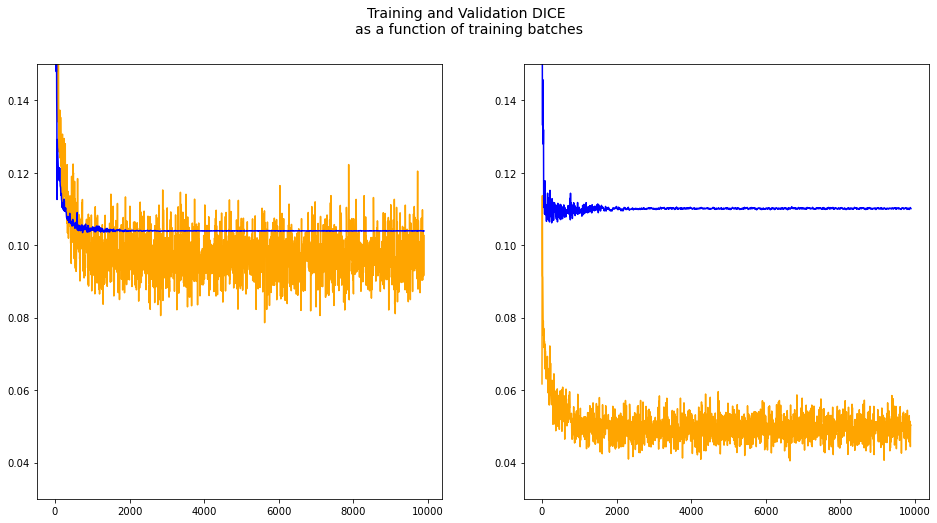

In [46]:
fig, ax = plt.subplots(1, 2, figsize=(16, 8), sharex=True)

ax[0].plot(x_batches_1, y1_trn_dice_1, c='orange')
ax[0].plot(x_batches_1, y2_val_dice_1, c='blue')

ax[1].plot(x_batches_2, y1_trn_dice_2, c='orange')
ax[1].plot(x_batches_2, y2_val_dice_2, c='blue')

# ax.set_xscale('log')
ax[0].set_ylim(bottom=0.03, top=0.15)
ax[1].set_ylim(bottom=0.03, top=0.15)


plt.suptitle('Training and Validation DICE \nas a function of training batches', size='14')

plt.show()

In [28]:
device = dlutil.utils.get_device()
device

device(type='cpu')

In [26]:
save = False
load = False
if save:
    torch.save(model, model_fp)
if load:
    pretrained_params = torch.load(model_fp)

## 3.1 Visualize results on vertex mesh

### 3.1.1 Load pixel2vertex maps

In [32]:
os.listdir('./models')
model_load_dir = './models/model_ots_fixed_inputs_unfreeze_last_3_finetune_0.0bce_2022-11-13'

In [33]:
reload_parameters = True
cpu = (device.type == 'cpu') 
device_string = 'cuda' if not cpu else 'cpu'  # in case model is saved from GPU but reloaded to CPU

if reload_parameters:
    
    # model_load_dir = './models/model_2022-10-12'
    # model_load_dir = model_save_dir
    model_state_fn, optim_state_fn = get_last_fns(model_load_dir)

    # reload model state dict
    with open(f'{model_load_dir}/{model_state_fn}', 'rb') as f:
        model_reload_dict = torch.load(f, map_location=torch.device(device_string))

    # reload optimizer state dict
    with open(f'{model_load_dir}/{optim_state_fn}', 'rb') as f:
        optim_reload_dict = torch.load(f, map_location=torch.device(device_string))
        
model.load_state_dict(model_reload_dict)

<All keys matched successfully>

In [34]:
from unet.pipeline_utilities import DESTRIEUX_FILENAME
import unet.pipeline_utilities as pu

In [35]:
from nilearn import surface, plotting

In [36]:
# data functions

def load_pickle(fp):
    """ Load single pickle file. 
    """
    import pickle
    with open(fp, 'rb') as f:
        p = pickle.load(f)
    return p


def load_numpy(fp):
    """ Load single numpy file. 
    """
    import numpy as np
    with open(fp, 'rb') as f:
        n = np.load(f)
    return n


def load_pickle_or_numpy_batch(fnames, 
                               prepend_fp=None, 
                               numpy=False):
    """ Load a series of pickle or saved numpy files
        into a list, and return the list.
    """
    import os
    
    if prepend_fp is not None:
        fps = [os.path.join(prepend_fp, n) for n in fnames]
    else:
        fps = fnames
        
    load = load_numpy if numpy else load_pickle

    return [load(fp) for fp in fps]


# vertex functions

def px2vx(px_np, px2vx_dict, vcoords, ignore=None):
    """ Translates an array of pixel-values to a statistical map
        that lives on a cortical surface, according to
        a supplied dictionary.
        Arguments:
            px_np: Array of pixel values of shape (xdim, ydim, ...)
            px2vx_dict: Dictionary whose keys are (i, j) pixel locations
                and whose values are lists of vertices corresponding
                to a given pixel in a given view of a cortex.
            vcoords: Coordinates of the cortical mesh
            ignore: Value not to include in arrays.
        Returns:
            The vmap (cortex) version of the supplied px_np array
            of pixel values.
    """
    vlen = vcoords.shape[0]
    vmap_shape = tuple([vlen] + list(px_np.shape[2:]))
    vmap = np.zeros(vmap_shape)
    n1 = px_np.shape[0]
    n2 = px_np.shape[1]
    for i in range(n1):
        for j in range(n2):
            v = px2vx_dict[(i, j)]
            if v != ignore:
                vmap[v] = px_np[i, j]
    return vmap


def make_mask_vmap(a, b, threshold_value=2.0, method=None):
    """ Make a mask (boolean) vmap based on which values
        are below an allowed maximum threshold of difference
        between pxcoords and vxcoords.
        Arguments:
            a, b: The two arrays to compare, of same shape
                (n_entries, n_coordinates). Distances are calculated
                on a sum over the coordinates (axis=1).
            threshold_value: the maximum theshold, a positive float
            method: how to calculate the distance to threshold,
                by default, absolute value. Can also be 'square'
                to calculate squared distance.
        Returns: a boolean array in the shape of a and b
    """
    fn = np.abs
    if method == 'square':
        fn = np.square
        
    diff_vmap = (fn(a - b)).sum(axis=1)
    mask_vmap = (diff_vmap > threshold_value)
    
    return mask_vmap


# analysis functions

def dice(target, prediction, target_label, pred_label=None):
    """ Calculates DICE by comparing target to prediction.
        'label' is the value of the label to compare.
    """
    if pred_label is None:
        pred_label = target_label
    lt = target == target_label
    lp = prediction == pred_label

    tp = sum(lt * lp)
    fp = sum(lp) - tp
    fn = sum(lt) - tp
    dice = (2 * tp) / (2 * tp + fp + fn)
    
    return dice

def average_dice(target, prediction, labels, return_all=False):
    dices = [dice(target, prediction, l) for l in labels]
    if return_all:
        return np.mean(dices), dices
    else:
        return np.mean(dices)

In [104]:
df_val = ds_val.xy_pairs
b = 3  # batch_number
df_batch = df_val.iloc[gp_ind[b]]

px2v_colname = 'Filename_v'
pcrd_colname = 'Filename_p'
px2v_fns = list(df_batch[px2v_colname])
pcrd_fns = list(df_batch[pcrd_colname])
eid = df_batch['EID'].iloc[0]

vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)

parc_subdir = 'parc'
surf_subdir = 'surf'
anat_data_dir = '/oak/stanford/groups/jyeatman/samjohns/samjohns-projects-backup/ots-data'

mesh_fn = 'lh.inflated'
parc_fn = f'{eid}-ots.npy'
curv_fn = 'lh.curv'

mesh_fp = os.path.join(anat_data_dir, eid, surf_subdir, mesh_fn)
parc_fp = os.path.join(base_data_dir, parc_subdir, parc_fn)
curv_fp = os.path.join(anat_data_dir, eid, surf_subdir, curv_fn)

mesh = surface.load_surf_mesh(mesh_fp)
parc = np.load(open(parc_fp, 'rb'))
parc = surface.load_surf_data(parc)
curv = surface.load_surf_data(curv_fp)

In [105]:
def aggregate_parc(parc):
    parc_copy = copy.deepcopy(parc)
    for k, v in ots_agg_dict.items():
        for val in v:
            parc_copy[parc_copy == val] = float(k)
    return parc_copy

hbn = False
ots = True

if hbn:
    parc_selected = pu.get_filtered_parc(parc, fill_value=0.0)
    
if ots:
    parc = aggregate_parc(parc)

In [106]:
di_val_eid_batches = iter(dl_val_eid_batches)

In [107]:
mesh.coordinates.shape

(114177, 3)

In [108]:
# get data batches
for i in range(b + 1):
    xs, ys = next(di_val_eid_batches)

xs = xs.to(device)
ys_np = ys.detach().numpy()

# get model predictions
ypreds = model(xs)
ypreds_softmax = F.softmax(ypreds, dim=1)

# reshape predictions and move to numpy
ypreds_np = ypreds.cpu().detach().numpy()
ypreds_softmax_np = ypreds_softmax.cpu().detach().numpy()
ypreds_softmax_np = np.transpose(ypreds_softmax_np, axes=(0, 2, 3, 1))  # place channel dim last
ypreds_np_argmax = np.argmax(ypreds_np, axis=1)  # eliminate channel dim by taking max

In [109]:
bsize = ys.shape[0]
pred_vmaps = []
prob_vmaps = []

for i in range(bsize):
    
    ypred_vmap = px2vx(ypreds_np_argmax[i], 
                       px2v_batch[i], 
                       mesh.coordinates)
    
    yprob_vmap = px2vx(ypreds_softmax_np[i], 
                       px2v_batch[i], 
                       mesh.coordinates)

    vcrd_vmap = px2vx(vcrd_batch[i],
                      px2v_batch[i],
                      mesh.coordinates)

    mask = make_mask_vmap(vcrd_vmap, mesh.coordinates)
    
    ypred_masked_vmap = ypred_vmap[:]
    ypred_masked_vmap[mask] = 0.0
    
    yprob_masked_vmap = yprob_vmap[:]
    yprob_masked_vmap[mask] = 0.0
    
    pred_vmaps.append(ypred_masked_vmap)
    prob_vmaps.append(yprob_masked_vmap)

pred_vmaps = np.stack(pred_vmaps)
prob_vmaps = np.stack(prob_vmaps)

In [110]:
nclasses = 3
classes = list(range(nclasses))
class_sums = []

for c in classes:
    class_sums.append(np.sum(pred_vmaps == c, axis=0))

class_sums = np.stack(class_sums)

threshold = 13
ensemble_prediction = np.zeros_like(class_sums)
ensemble_prediction[class_sums >= threshold] = 1.0

In [111]:
c = 2
y_view = plotting.view_surf(mesh, ensemble_prediction[c], bg_map=curv, cmap='tab20', threshold=0.5)
y_view

In [112]:
g_view = plotting.view_surf(mesh, parc == 2, bg_map=curv, cmap='tab20', threshold=0.5)
g_view

In [118]:
dice(parc, ensemble_prediction[2], target_label=2.0, pred_label=1.0)

0.8025773195876289

In [115]:
diff = ensemble_prediction[2] - 2 * (parc == 2)

In [116]:
d_view = plotting.view_surf(mesh, diff, bg_map=curv, cmap='tab10', threshold=0.5)
d_view

In [50]:
d_view.save_as_html('difference_map_3d_ots_multiple_unfrozen_layers.html')

## 3.2 Calculate DICE

In [86]:
df_val = ds_val.xy_pairs

In [87]:
[len(x) for x in gp_ind]

[15, 40, 40, 40, 40, 40, 40, 40, 40, 40]

In [53]:
def load_subject_data_for_prediction(eid, 
                                     data_type='ots', 
                                     anat_dir=None, 
                                     base_data_dir=None
                                    ):
    """
        Load subject anatomical data for use in multi-view prediction.
        Different logic for different sources of data.
        Arguments:
            eid: (str) subject identifier
            data_type: (string, optional) 'hbn' or 'ots'
            anat_dir: (string, optional) base directory in which
                to find freesurfer derivatives, e.g. ./surf, etc.
        Returns:
            a dictionary with keys, values:
                'mesh': desired cortical mesh
                'curv': curvature stat map adapted to the above mesh
                'parc': processed parcelation, either a subselection
                    of Destrieux labels if data_type='hbn', otherwise
                    a retrieved manual parcellation from a different
                    directory if data_type='ots'
    
    """
    from unet.pipeline_utilities import DESTRIEUX_FILENAME
    from unet.pipeline_utilities import get_filtered_parc
    
    mesh_fn = 'lh.inflated'
    parc_fn = DESTRIEUX_FILENAME
    curv_fn = 'lh.curv'

    # different loading logic depending on data source (hbn vs. ots)
    # logic for hbn
    if data_type == 'hbn':
        
        if anat_dir is None:
            
            anat_dir = '/oak/stanford/groups/jyeatman/HBN/BIDS_curated/derivatives/freesurfer'
        
        surf_dir = 'surf'
        parc_dir = 'label'

        mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
        parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)
        curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)

        mesh = surface.load_surf_mesh(mesh_fp)
        parc = surface.load_surf_data(parc_fp)
        curv = surface.load_surf_data(curv_fp)

        # parse out parcellation
        parc_selected = get_filtered_parc(parc, fill_value=0.0)

    # logic for ots
    elif data_type == 'ots':
        
        if base_data_dir is None:
            base_data_dir = '/scratch/groups/jyeatman/samjohns-projects/data/atlas/ots-sulc'

        parc_subdir = 'parc'
        surf_subdir = 'surf'
        anat_data_dir = '/oak/stanford/groups/jyeatman/samjohns/samjohns-projects-backup/ots-data'

        mesh_fn = 'lh.inflated'
        parc_fn = f'{eid}-ots.npy'
        curv_fn = 'lh.curv'

        mesh_fp = os.path.join(anat_data_dir, eid, surf_subdir, mesh_fn)
        parc_fp = os.path.join(base_data_dir, parc_subdir, parc_fn)
        curv_fp = os.path.join(anat_data_dir, eid, surf_subdir, curv_fn)

        mesh = surface.load_surf_mesh(mesh_fp)
        parc = np.load(open(parc_fp, 'rb'))
        parc = surface.load_surf_data(parc)  # TODO: Is this line redundant?
        curv = surface.load_surf_data(curv_fp)

        # parse out parcellation
        parc_selected = aggregate_parc(parc)
    
    else:
        raise NotImplementedError('Data type provided is not supported.')
    
    return {'mesh': mesh, 
            'curv': curv, 
            'parc': parc_selected
           }

In [88]:
preds_from_file = False  # whether to load nn predictions from saved files
overwrite_saved_sums = True
enforce_batch_size = False
hbn = False

nbatches = len(gp_ind)
batch_size = 40
# thresholds = list(range(1, batch_size))
thresholds = list(range(1, 10, 2))
class_range = list(range(3, 21)) if hbn else list(range(3))

In [64]:
result_dir = f'./results/ots_{date}'
os.makedirs(result_dir, exist_ok=True)

In [65]:
threshold_dice_dict = {}
for threshold in thresholds:  # loop over different aggregation schemes
    
    threshold_dices = []
    di_val_eid_batches = iter(dl_val_eid_batches)  # restart iterator
    
    for batch, (xs, ys) in enumerate(di_val_eid_batches):  # loop over batches
        
        if enforce_batch_size and (batch < batch_size):
            continue

        df_batch = df_val.iloc[gp_ind[batch]]

        # load px2v data to translate from pixel to cortex mesh
        px2v_colname = 'Filename_v'
        pcrd_colname = 'Filename_p'
        px2v_fns = list(df_batch[px2v_colname])
        pcrd_fns = list(df_batch[pcrd_colname])
        eid = df_batch['EID'].iloc[0]

        vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
        px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)
        
        # load freesurfer data
        mesh_fn = 'lh.inflated'
        parc_fn = DESTRIEUX_FILENAME
        curv_fn = 'lh.curv'

        # different loading logic depending on data source (hbn vs. ots)
        # logic for hbn
        if hbn: 
            
            mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
            parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)
            curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)

            mesh = surface.load_surf_mesh(mesh_fp)
            parc = surface.load_surf_data(parc_fp)
            curv = surface.load_surf_data(curv_fp)
            
            # parse out parcellation
            parc_selected = pu.get_filtered_parc(parc, fill_value=0.0)

        # logic for ots
        else:
            
            parc_subdir = 'parc'
            surf_subdir = 'surf'
            anat_data_dir = '/oak/stanford/groups/jyeatman/samjohns/samjohns-projects-backup/ots-data'
            
            mesh_fn = 'lh.inflated'
            parc_fn = f'{eid}-ots.npy'
            curv_fn = 'lh.curv'

            mesh_fp = os.path.join(anat_data_dir, eid, surf_subdir, mesh_fn)
            parc_fp = os.path.join(base_data_dir, parc_subdir, parc_fn)
            curv_fp = os.path.join(anat_data_dir, eid, surf_subdir, curv_fn)

            mesh = surface.load_surf_mesh(mesh_fp)
            parc = np.load(open(parc_fp, 'rb'))
            parc = surface.load_surf_data(parc)  # TODO: Is this line redundant?
            curv = surface.load_surf_data(curv_fp)
        
            # parse out parcellation
            parc_selected = aggregate_parc(parc)

        xs = xs.to(device)
        ys_np = ys.detach().numpy()

        # get model predictions, either from previously saved files
        # or by applying the trained model to the current batch
        if preds_from_file:
            with open(f'pred_dict_{batch}.pkl', 'rb') as f:
                pred_dict = pickle.load(f)
            ypreds = torch.Tensor(pred_dict['yhat'])
        else:
            ypreds = model(xs)
        
        ypreds_softmax = F.softmax(ypreds, dim=1)

        # reshape predictions and move to numpy
        ypreds_np = ypreds.cpu().detach().numpy()
        ypreds_softmax_np = ypreds_softmax.cpu().detach().numpy()
        ypreds_softmax_np = np.transpose(ypreds_softmax_np, axes=(0, 2, 3, 1))  # place channel dim last
        ypreds_np_argmax = np.argmax(ypreds_np, axis=1)  # eliminate channel dim by taking max

        # skip current loop unless there are batch_size examples in batch
        if enforce_batch_size and (ys.shape[0] != batch_size):  
            continue
        
        sampled_batch_size = ys.shape[0]
            
        pred_vmaps = []
        prob_vmaps = []

        for i in range(sampled_batch_size):

            ypred_vmap = px2vx(ypreds_np_argmax[i], 
                               px2v_batch[i], 
                               mesh.coordinates)

            yprob_vmap = px2vx(ypreds_softmax_np[i], 
                               px2v_batch[i], 
                               mesh.coordinates)

            vcrd_vmap = px2vx(vcrd_batch[i],
                              px2v_batch[i],
                              mesh.coordinates)

            mask = make_mask_vmap(vcrd_vmap, mesh.coordinates)

            ypred_masked_vmap = ypred_vmap[:]
            ypred_masked_vmap[mask] = 0.0

            yprob_masked_vmap = yprob_vmap[:]
            yprob_masked_vmap[mask] = 0.0

            pred_vmaps.append(ypred_masked_vmap)
            prob_vmaps.append(yprob_masked_vmap)

        pred_vmaps = np.stack(pred_vmaps)
        prob_vmaps = np.stack(prob_vmaps)

        if hbn:
            
            nclasses = 21
            classes = list(range(nclasses))
        
        else:
            classes = class_range
        
        class_sums = []

        for c in classes:
            class_sums.append(np.sum(pred_vmaps == c, axis=0))

        class_sums = np.stack(class_sums)
        class_sum_fn = f'{result_dir}/ots_class_sums_{eid}.npy'
        
        if (not os.path.exists(class_sum_fn)) or overwrite_saved_sums:
            with open(class_sum_fn, 'wb') as f:
                np.save(f, class_sums)
        
        ensemble_prediction = np.zeros_like(class_sums)
        ensemble_prediction[class_sums >= threshold] = 1.0
        
        grnd = parc_selected
        yhat = ensemble_prediction[c]

        dices_by_class = []
        
        if hbn:
            class_range = list(range(3, 21))
        
        for c in class_range:

            grnd = parc_selected
            yhat = ensemble_prediction[c]
            d = dice(grnd, yhat, target_label=c, pred_label=1.0)
            dices_by_class.append(d)
        
        threshold_dices.append(dices_by_class)
        
        del mesh
        del parc
        del curv
        
    threshold_dice_dict[threshold] = threshold_dices
    with open(f'{result_dir}/ots_threshold_dice_dict_{threshold}.pkl', 'wb') as f:
        pickle.dump(threshold_dice_dict, f)

In [128]:
load_class_sums = True
threshold_dice_dict = {}
thresholds = list(range(1, 14, 2))

for threshold in thresholds:  # loop over different aggregation schemes
    
    threshold_dices = []
    di_val_eid_batches = iter(dl_val_eid_batches)  # restart iterator
    
    for batch, (xs, ys) in enumerate(di_val_eid_batches):  # loop over batches
        
        if enforce_batch_size and (batch < batch_size):
            continue

        df_batch = df_val.iloc[gp_ind[batch]]

        # load px2v data to translate from pixel to cortex mesh
        px2v_colname = 'Filename_v'
        pcrd_colname = 'Filename_p'
        px2v_fns = list(df_batch[px2v_colname])
        pcrd_fns = list(df_batch[pcrd_colname])
        eid = df_batch['EID'].iloc[0]

        vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
        px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)
        
        # load freesurfer data
        mesh_fn = 'lh.inflated'
        parc_fn = DESTRIEUX_FILENAME
        curv_fn = 'lh.curv'

        # different loading logic depending on data source (hbn vs. ots)
        # logic for hbn
        if hbn: 
            
            mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
            parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)
            curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)

            mesh = surface.load_surf_mesh(mesh_fp)
            parc = surface.load_surf_data(parc_fp)
            curv = surface.load_surf_data(curv_fp)
            
            # parse out parcellation
            parc = pu.get_filtered_parc(parc, fill_value=0.0)

        # logic for ots
        else:
            
            parc_subdir = 'parc'
            surf_subdir = 'surf'
            anat_data_dir = '/oak/stanford/groups/jyeatman/samjohns/samjohns-projects-backup/ots-data'
            
            mesh_fn = 'lh.inflated'
            parc_fn = f'{eid}-ots.npy'
            curv_fn = 'lh.curv'

            mesh_fp = os.path.join(anat_data_dir, eid, surf_subdir, mesh_fn)
            parc_fp = os.path.join(base_data_dir, parc_subdir, parc_fn)
            curv_fp = os.path.join(anat_data_dir, eid, surf_subdir, curv_fn)

            mesh = surface.load_surf_mesh(mesh_fp)
            parc = np.load(open(parc_fp, 'rb'))
            parc = surface.load_surf_data(parc)  # TODO: Is this line redundant?
            curv = surface.load_surf_data(curv_fp)
        
        class_sum_fn = f'{result_dir}/ots_class_sums_{eid}.npy'
        
        if load_class_sums:
            with open(class_sum_fn, 'rb') as f:
                class_sums = np.load(f)
        
        ensemble_prediction = np.zeros_like(class_sums)
        ensemble_prediction[class_sums >= threshold] = 1.0
        dices_by_class = []
        
        if hbn:
            class_range = list(range(3, 21))
        
        for c in class_range:

            grnd = aggregate_parc(parc)
            yhat = ensemble_prediction[c]
            d = dice(grnd, yhat, target_label=c, pred_label=1.0)
            dices_by_class.append(d)
        
        threshold_dices.append(dices_by_class)
        
        del mesh
        del parc
        del curv
        
    threshold_dice_dict[threshold] = threshold_dices
    with open(f'{result_dir}/ots_threshold_dice_dict_{threshold}.pkl', 'wb') as f:
        pickle.dump(threshold_dice_dict, f)

In [129]:
mean_dices = []
for i, d in threshold_dice_dict.items():
    md = np.mean(d, axis=0)[2]
    mean_dices.append(md)

In [130]:
thresholds = list(threshold_dice_dict.keys())

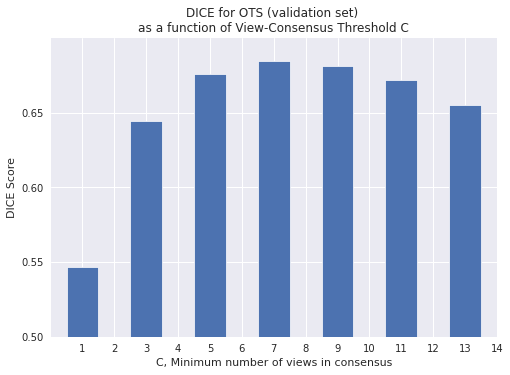

In [132]:
x, y = thresholds, mean_dices

plt.style.use('seaborn')
fig, ax = plt.subplots()

ax.bar(x, y, width=1, edgecolor="white", linewidth=0.7)
ax.set(xlim=(0, 10), xticks=np.arange(1, 15),
       ylim=(0.5, 0.7), yticks=np.arange(0.5, 0.7, 0.05))

plt.title('DICE for OTS (validation set) \n'
          'as a function of View-Consensus Threshold C')
plt.xlabel('C, Minimum number of views in consensus')
plt.ylabel('DICE Score')
plt.show()


In [ ]:
# for calculating DICE from saved vmap files
# in this case, class_sums (# of positive predictions per class)

load_vmaps = False  # whether to load nn predictions from saved files
save_dice_dict = False # whether to save predictions

z_mask = True
z_mask_threshold = 0.0

ots = True
hbn = False

nbatches = len(gp_ind)
batch_size = 48
# thresholds = list(range(1, batch_size))
thresholds = list(range(1, min([len(x) for x in gp_ind])))
threshold_dice_dict = {}

for threshold in thresholds:  # loop over different aggregation schemes
    
    threshold_dices = []
    di_val_eid_batches = iter(dl_val_eid_batches)  # restart iterator
    
    for batch in range(len(gp_ind)):  # loop over batches

        df_batch = df_val.iloc[gp_ind[batch]]
        if enforce_batch_size and len(df_batch) != batch_size:
            continue

        # load px2v data to translate from pixel to cortex mesh
        px2v_colname = 'Filename_v'
        pcrd_colname = 'Filename_p'
        px2v_fns = list(df_batch[px2v_colname])
        pcrd_fns = list(df_batch[pcrd_colname])
        eid = df_batch['EID'].iloc[0]

        vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
        px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)
        
        # load freesurfer data
        dt = 'hbn' if hbn else 'ots'
        load_dict = load_subject_data_for_prediction(eid, data_type=dt)
        mesh = load_dict['mesh']
        curv = load_dict['curv']
        parc = load_dict['parc']

        class_sum_fn = f'ots_class_sums_{eid}.npy'
        
        # load previously computed class counts from file
        if os.path.exists(class_sum_fn) and load_vmaps:
            with open(class_sum_fn, 'rb') as f:
                class_sums = np.load(f, allow_pickle=True)
        
        ensemble_prediction = np.zeros_like(class_sums)
        ensemble_prediction[class_sums >= threshold] = 1.0
        
        if z_mask:

            ensemble_prediction[:, mesh.coordinates[:, 2] > z_mask_threshold] = 0.0

        dices_by_class = []
        for c in class_range:

            grnd = parc
            yhat = ensemble_prediction[c]
            tlab = c - 2 if hbn else c
            
            d = dice(grnd, yhat, target_label=tlab, pred_label=1.0)
            dices_by_class.append(d)
        
        threshold_dices.append(dices_by_class)
        
        del mesh
        del parc
        del curv
        
    threshold_dice_dict[threshold] = threshold_dices
    with open(f'ots-zmask-threshold_dice_dict_{threshold}.pkl', 'wb') as f:
        pickle.dump(threshold_dice_dict, f)

In [65]:
preds_from_file = False  # whether to load nn predictions from saved files
overwrite_saved_sums = True

nbatches = len(gp_ind)
batch_size = 48
# thresholds = list(range(1, batch_size))
thresholds = list(range(1, 10, 2))
threshold_dice_dict = {}

for threshold in thresholds:  # loop over different aggregation schemes
    
    threshold_dices = []
    di_val_eid_batches = iter(dl_val_eid_batches)  # restart iterator
    
    for batch, (xs, ys) in enumerate(di_val_eid_batches):  # loop over batches
        
        if batch < 42:
            continue

        df_batch = df_val.iloc[gp_ind[batch]]

        # load px2v data to translate from pixel to cortex mesh
        px2v_colname = 'Filename_v'
        pcrd_colname = 'Filename_p'
        px2v_fns = list(df_batch[px2v_colname])
        pcrd_fns = list(df_batch[pcrd_colname])
        eid = df_batch['EID'].iloc[0]

        vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
        px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)
        
        # load freesurfer data
        mesh_fn = 'lh.inflated'
        parc_fn = DESTRIEUX_FILENAME
        curv_fn = 'lh.curv'

        mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
        parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)
        curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)

        mesh = surface.load_surf_mesh(mesh_fp)
        parc = surface.load_surf_data(parc_fp)
        curv = surface.load_surf_data(curv_fp)

        parc_selected = pu.get_filtered_parc(parc, fill_value=0.0)

        xs = xs.to(device)
        ys_np = ys.detach().numpy()

        # get model predictions, either from previously saved files
        # or by applying the trained model to the current batch
        if preds_from_file:
            with open(f'pred_dict_{batch}.pkl', 'rb') as f:
                pred_dict = pickle.load(f)
            ypreds = torch.Tensor(pred_dict['yhat'])
        else:
            ypreds = model(xs)
        
        ypreds_softmax = F.softmax(ypreds, dim=1)

        # reshape predictions and move to numpy
        ypreds_np = ypreds.cpu().detach().numpy()
        ypreds_softmax_np = ypreds_softmax.cpu().detach().numpy()
        ypreds_softmax_np = np.transpose(ypreds_softmax_np, axes=(0, 2, 3, 1))  # place channel dim last
        ypreds_np_argmax = np.argmax(ypreds_np, axis=1)  # eliminate channel dim by taking max

        if ys.shape[0] != batch_size:  # skip current loop unless there are 48 examples in batch
            continue
            
        pred_vmaps = []
        prob_vmaps = []

        for i in range(batch_size):

            ypred_vmap = px2vx(ypreds_np_argmax[i], 
                               px2v_batch[i], 
                               mesh.coordinates)

            yprob_vmap = px2vx(ypreds_softmax_np[i], 
                               px2v_batch[i], 
                               mesh.coordinates)

            vcrd_vmap = px2vx(vcrd_batch[i],
                              px2v_batch[i],
                              mesh.coordinates)

            mask = make_mask_vmap(vcrd_vmap, mesh.coordinates)

            ypred_masked_vmap = ypred_vmap[:]
            ypred_masked_vmap[mask] = 0.0

            yprob_masked_vmap = yprob_vmap[:]
            yprob_masked_vmap[mask] = 0.0

            pred_vmaps.append(ypred_masked_vmap)
            prob_vmaps.append(yprob_masked_vmap)

        pred_vmaps = np.stack(pred_vmaps)
        prob_vmaps = np.stack(prob_vmaps)

        nclasses = 21
        classes = list(range(nclasses))
        class_sums = []

        for c in classes:
            class_sums.append(np.sum(pred_vmaps == c, axis=0))

        class_sums = np.stack(class_sums)
        class_sum_fn = f'class_sums_{eid}.npy'
        if (not os.path.exists(class_sum_fn)) or overwrite_saved_sums:
            with open(class_sum_fn, 'wb') as f:
                np.save(f, class_sums)
        
        ensemble_prediction = np.zeros_like(class_sums)
        ensemble_prediction[class_sums >= threshold] = 1.0
        
        grnd = parc_selected
        yhat = ensemble_prediction[c]

        dices_by_class = []
        for c in range(3, 21):

            grnd = parc_selected
            yhat = ensemble_prediction[c]
            d = dice(grnd, yhat, target_label=(c-2), pred_label=1.0)
            dices_by_class.append(d)
        
        threshold_dices.append(dices_by_class)
        
        del mesh
        del parc
        del curv
        
    threshold_dice_dict[threshold] = threshold_dices
    with open(f'threshold_dice_dict_{threshold}.pkl', 'wb') as f:
        pickle.dump(threshold_dice_dict, f)

NameError: name 'threshold_dice_dict' is not defined

In [ ]:
# for calculating DICE from saved vmap files
# in this case, class_sums (# of positive predictions per class)

load_vmaps = True  # whether to load nn predictions from saved files

nbatches = len(gp_ind)
batch_size = 48
# thresholds = list(range(1, batch_size))
thresholds = list(range(11, 48, 2))
threshold_dice_dict = {}

for threshold in thresholds:  # loop over different aggregation schemes
    
    threshold_dices = []
    di_val_eid_batches = iter(dl_val_eid_batches)  # restart iterator
    
    for batch in range(1, len(gp_ind)):  # loop over batches

        df_batch = df_val.iloc[gp_ind[batch]]
        if len(df_batch) != batch_size:
            continue

        # load px2v data to translate from pixel to cortex mesh
        px2v_colname = 'Filename_v'
        pcrd_colname = 'Filename_p'
        px2v_fns = list(df_batch[px2v_colname])
        pcrd_fns = list(df_batch[pcrd_colname])
        eid = df_batch['EID'].iloc[0]

        vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
        px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)
        
        # load freesurfer data
        mesh_fn = 'lh.inflated'
        parc_fn = DESTRIEUX_FILENAME
        curv_fn = 'lh.curv'

        mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
        parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)
        curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)

        mesh = surface.load_surf_mesh(mesh_fp)
        parc = surface.load_surf_data(parc_fp)
        curv = surface.load_surf_data(curv_fp)

        parc_selected = pu.get_filtered_parc(parc, fill_value=0.0)

        nclasses = 21
        classes = list(range(nclasses))

        class_sum_fn = f'class_sums_{eid}.npy'
        
        # load previously computed class counts from file
        if os.path.exists(class_sum_fn) and load_vmaps:
            with open(class_sum_fn, 'rb') as f:
                class_sums = np.load(f, allow_pickle=True)
        
        ensemble_prediction = np.zeros_like(class_sums)
        ensemble_prediction[class_sums >= threshold] = 1.0

        dices_by_class = []
        for c in range(3, 21):

            grnd = parc_selected
            yhat = ensemble_prediction[c]
            d = dice(grnd, yhat, target_label=(c-2), pred_label=1.0)
            dices_by_class.append(d)
        
        threshold_dices.append(dices_by_class)
        
        del mesh
        del parc
        del curv
        
    threshold_dice_dict[threshold] = threshold_dices
    with open(f'threshold_dice_dict_{threshold}.pkl', 'wb') as f:
        pickle.dump(threshold_dice_dict, f)

In [18]:
dice_fns = [fn for fn in os.listdir() if 'threshold' in fn]

# load saved dice dictionaries
dices = []
for dice_fn in dice_fns:
    with open(dice_fn, 'rb') as f:
        dice_dict = pickle.load(f)
        dices.append(dice_dict)

In [36]:
dice_summaries_dict = {}
for d_dict in dices:
    
    k = max(d_dict.keys())
    d_list = d_dict[k]
    
    d_np = np.array(d_list)
    d_sums = d_np.mean(axis=0)
    d_stes = d_np.std(axis=0)/(d_np.shape[0])
    
    dice_summaries_entry = {'mean': d_sums, 'ste': d_stes}
    dice_summaries_dict[k] = dice_summaries_entry

In [38]:
dice_summaries_dict.keys()

dict_keys([1, 3, 7, 5, 9, 11])

In [43]:
n_classes = dice_summaries_dict[11]['mean'].shape[0]


In [44]:
n_classes

18

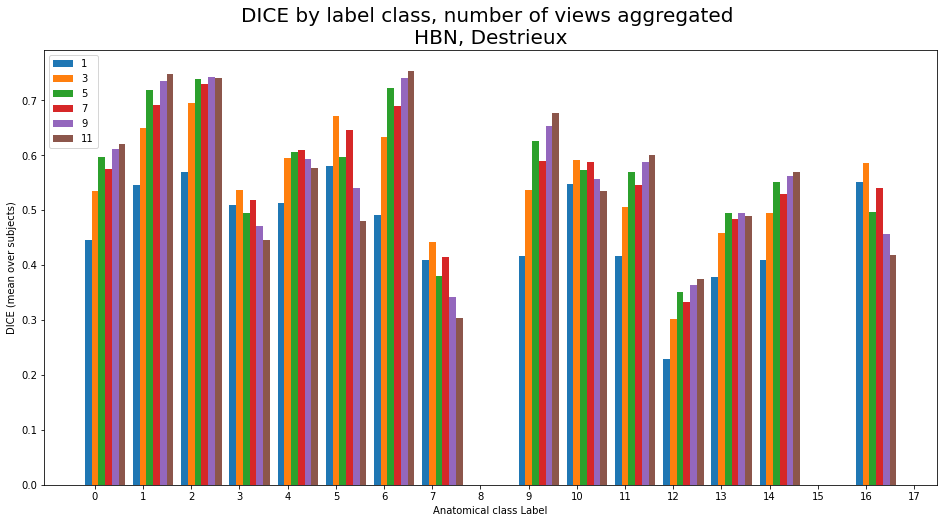

In [106]:
# bar graph
fig, ax = plt.subplots(figsize=(16, 8))
x = np.arange(n_classes)
y1 = dice_summaries_dict[1]['mean']
y2 = dice_summaries_dict[11]['mean']
ys = [dice_summaries_dict[i]['mean'] for i in dice_summaries_dict.keys()]
# ys = [y1, y2]
width = 0.14
for i, y in enumerate(ys):
    ax.bar(x + i * width, y, width, 
           color=list(plt.rcParams['axes.prop_cycle'])[i]['color'])
    ax.set_xticks(x + width)
    ax.set_xticklabels(x)
    ax.legend([2*i + 1 for i in x])
ax.set_title('DICE by label class, number of views aggregated \n'
             'HBN, Destrieux', size=20.0)
ax.set_xlabel('Anatomical class Label')
ax.set_ylabel('DICE (mean over subjects)')
plt.show()

In [75]:
ys_means = []
ys_stds = []
for y in ys:
    y_zero_nan = y[:]
    y_zero_nan[y_zero_nan == 0.0] = np.nan
    ys_means.append(np.nanmean(y_zero_nan))
    ys_stds.append(np.nanstd(y_zero_nan))

In [99]:
ys_stes = [s/np.sqrt(92) for s in ys_stds]

In [100]:
ys_means, ys_stes

([0.43829632288059306,
  0.5488690054484466,
  0.5678502118254499,
  0.565692024652973,
  0.5636375231156181,
  0.5557907204674742],
 [0.014945324818217988,
  0.01025192124663677,
  0.011428531526163334,
  0.010634217263519381,
  0.012606257756716657,
  0.0139932367179717])

Text(0, 0.5, 'DICE (averaged over classes)')

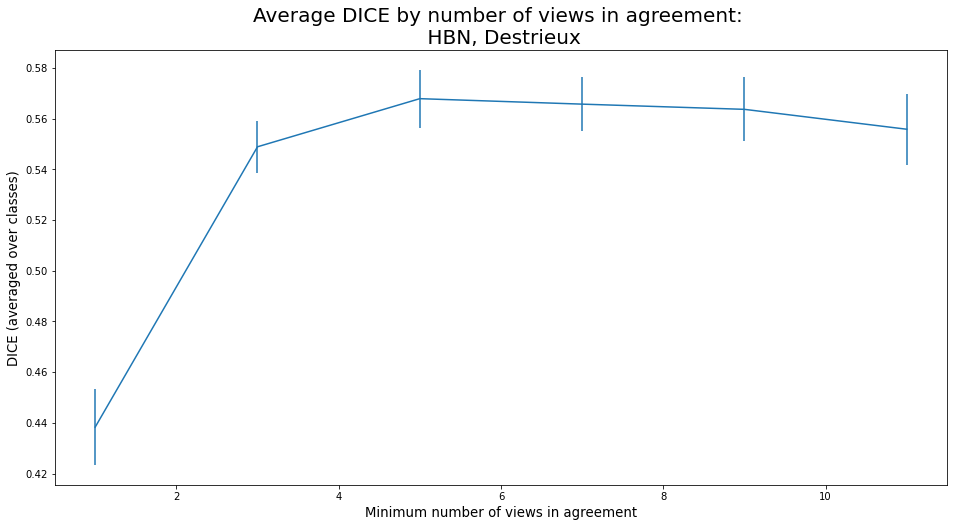

In [107]:
fig, ax = plt.subplots(figsize=(16, 8))
text_size = 20.0
ax.errorbar(list(range(1, 12, 2)), ys_means, yerr=ys_stes)
ax.set_title('Average DICE by number of views in agreement: \n HBN, Destrieux', size=text_size)
ax.set_xlabel('Minimum number of views in agreement', size=text_size/1.5)
ax.set_ylabel('DICE (averaged over classes)', size=text_size/1.5)

# 4. Transfer learning: run regression

- Define datasets / dataloaders
- Define model
- Initialize parameters from UNet
- Train

## 4.1 Make dataset

- dataset and dataloaders for HBN data

In [7]:
# image data and (pretrained) model data

base_dir ='/scratch/groups/jyeatman/samjohns-projects'
reg_save_dir = f'{base_dir}/models/unet-regression/6-22.1'
os.makedirs(reg_save_dir, exist_ok=True)
data_dir_base = '/scratch/groups/jyeatman/samjohns-projects/data'
xdir = '/scratch/groups/jyeatman/samjohns-projects/data/parc-images-jitter-processed/curv-trans'
ydir_pheno = data_dir_base + '/hbn-reading-age-data'

model_save_dir = './model_checkpoints_parcellation-5-13.2'
os.makedirs(model_save_dir, exist_ok=True)

### Skip this section if dataframe is already made

In [11]:
# (y) phenotypic data processing

ydir_pheno = '../data/hbn-reading-age-data'
age_df = pd.read_csv(ydir_pheno + '/hbn_ages_blanks.csv', header=None)
read_df = pd.read_csv(ydir_pheno + '/wiat_reading.csv', header=None)
age_df.columns = ['EID', 'Age']
read_df.columns = ['EID', 'Read']
age_df = age_df[age_df.Age != ' ']
read_df = read_df[read_df.Read != ' ']

df_y = pd.merge(age_df, read_df, on='EID', how='left')
df_y = df_y.dropna()
df_y.columns = ['EID', 'Age', 'Read']

In [8]:
# (x) image data

x_fnames = os.listdir(xdir)
x_eids = [s[:16] for s in x_fnames]
df_x = pd.DataFrame({'EID': x_eids, 'Filename': x_fnames})

In [9]:
# combined data

df_xy = pd.merge(df_x, df_y, on='EID', how='left')
df_xy = df_xy.dropna()
df_xy = df_xy.reindex(columns=['Filename', 'Read', 'Age', 'EID'])

# save out label file

regression_mapping_fname = f'{data_dir_base}/mapping_regression.csv'
save = True
if save:
    df_xy.to_csv(regression_mapping_fname, index=False)

In [13]:
# df_map_test = pd.read_csv(regression_mapping_fname)
# df_map_test.head()

# NB: Load from here if regression file is already made

In [32]:
df_xy = pd.read_csv(f'{data_dir_base}/mapping_regression.csv')
df_xy.head()

,Filename,Read,Age,EID
0,sub-NDARDU602LPX-206.64-85.88-curv-trans--2--1...,107.0,12,sub-NDARDU602LPX
1,sub-NDARWE818UA6-219.09-76.41-curv-trans--16-8...,110.0,16,sub-NDARWE818UA6
2,sub-NDARMA598JTX-212.60-95.18-curv-trans-0-0.npy,76.0,8,sub-NDARMA598JTX
3,sub-NDARXB286YBR-212.59-97.32-curv-trans--9-9.npy,107.0,8,sub-NDARXB286YBR
4,sub-NDARME930DE7-220.39-89.77-curv-trans--18--...,97.0,10,sub-NDARME930DE7


In [37]:
# split data into train and test, respecting EIDs

eids = list(set(df_xy['EID']))
n_eids = len(eids)
test_eids = list(np.random.choice(eids, size=n_eids//10, replace=False))
train_eids = list(set(eids) - set(test_eids))
indices = list(range(len(df_xy)))

df_xy['Index'] = indices
df_xy['Test'] = df_xy['EID'].isin(test_eids)


In [ ]:
df_xy.to_csv(f'{data_dir_base}/pca-dataset.csv', index=False)

## NB: Load from here if df_xy with indices is already created

In [8]:
df_path = f'{data_dir_base}/pca-dataset.csv'
df_xy = pd.read_csv(df_path)

In [9]:
test_indices = list(df_xy[df_xy.Test==True]['Index'])
train_indices = list(df_xy[df_xy.Test==False]['Index'])

In [10]:
# save out test, train split
save = False
if save:
    with open(f'{reg_save_dir}/test-train-indices.pkl', 'wb') as f:
        pickle.dump({'train': train_indices, 'test': test_indices}, f)

## Define dataset and dataloaders

In [11]:
# dataset
trf = transforms.Compose([transforms.ToTensor(), user.data.ToFloat()])
ds = user.data.CustomImageDataset(df_path,
                                  xdir, transform=trf, target_transform=user.data.ToFloat(),
                                  npy=True)
# test split
ds_train = torch.utils.data.Subset(ds, train_indices)
ds_test = torch.utils.data.Subset(ds, test_indices)

# dataloaders
bs = 32
dl_train = DataLoader(ds_train, batch_size=bs, shuffle=False)
dl_test = DataLoader(ds_test, batch_size=bs, shuffle=False)

In [12]:
tx, ty = next(iter(dl_train))
tx.shape, ty.shape, tx.dtype, ty.dtype

(torch.Size([32, 1, 256, 256]), torch.Size([32]), torch.float32, torch.float32)

## 4.2 Define model + initialize parameters

In [13]:
model_fp = f'{model_save_dir}/model009000.pkl'
pretrained_params = torch.load(model_fp)

In [14]:
class LNet(unet.UNet):
    def __init__(self, feature_count, class_count, fc_list=None,
                 pretrained_weights=None,
                 apply_sigmoid=False, return_type=None):
        super().__init__(feature_count=feature_count, 
                         class_count=class_count,
                         apply_sigmoid=apply_sigmoid)
        
        # load weights into UNet backbone
        if pretrained_weights is not None:
            if not isinstance(pretrained_weights, collections.OrderedDict):
                raise TypeError('Must be Pytorch params, which are an Ordered Dict.')
            else:
                self.load_state_dict(pretrained_weights)
        
        self.pool = nn.AdaptiveAvgPool2d(output_size=(1, 1))
        
        # parse return-type inputs
        if return_type is None:
            self.return_type = 'Prediction'
        else:
            self.return_type = return_type          
        
        # parse fc inputs
        manual_pool = True
        if manual_pool:
            fc_in = 512
        else:
            fc_in = 1000

        if fc_list is None:
            fc_list = [256, 64, 1]
        fcs = [fc_in] + fc_list
        self.fcs = nn.ModuleList()
        for i, o in zip(fcs[:-1], fcs[1:]):
            self.fcs.append(nn.Linear(i, o))
            
        # cache middle state
        self.middle = None
            
    def forward(self, x):
        x = self.layer0(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        # return the middle layer
        if self.return_type == 'middle':
            return x
        # otherwise, continue...
        x = self.pool(x)
        x = torch.flatten(x, start_dim=1)
        if self.return_type == 'middle_flat':
            return x
        for fc in self.fcs:
            x = F.elu(fc(x))
        return x

In [15]:
n_orig_classes = 21
in_channels = 1
lnet = LNet(feature_count=in_channels, class_count=n_orig_classes, return_type='middle_flat')

In [16]:
device = user.utils.get_device()
lnet.to(device)
device

device(type='cuda', index=0)

In [17]:
summary(lnet, (1, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 64, 128, 128]        --
├─ResNet: 1                              []                        --
|    └─Conv2d: 2-1                       [-1, 64, 128, 128]        3,136
├─Sequential: 1                          []                        --
|    └─Conv2d: 2-2                       [-1, 64, 128, 128]        (recursive)
├─ResNet: 1                              []                        --
|    └─BatchNorm2d: 2-3                  [-1, 64, 128, 128]        128
├─Sequential: 1                          []                        --
|    └─BatchNorm2d: 2-4                  [-1, 64, 128, 128]        (recursive)
├─ResNet: 1                              []                        --
|    └─ReLU: 2-5                         [-1, 64, 128, 128]        --
├─Sequential: 1                          []                        --
|    └─ReLU: 2-6                         [-1, 64, 128, 128]    

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 64, 128, 128]        --
├─ResNet: 1                              []                        --
|    └─Conv2d: 2-1                       [-1, 64, 128, 128]        3,136
├─Sequential: 1                          []                        --
|    └─Conv2d: 2-2                       [-1, 64, 128, 128]        (recursive)
├─ResNet: 1                              []                        --
|    └─BatchNorm2d: 2-3                  [-1, 64, 128, 128]        128
├─Sequential: 1                          []                        --
|    └─BatchNorm2d: 2-4                  [-1, 64, 128, 128]        (recursive)
├─ResNet: 1                              []                        --
|    └─ReLU: 2-5                         [-1, 64, 128, 128]        --
├─Sequential: 1                          []                        --
|    └─ReLU: 2-6                         [-1, 64, 128, 128]    

In [18]:
def make_pretrained_state_dict(model_state, pretrained_state):
    pd = pretrained_state
    sd = model_state
    warmstart_params = copy.deepcopy(sd)
    for k, v in pd.items():
        warmstart_params[k] = v
    return warmstart_params

In [19]:
warmstart_params = make_pretrained_state_dict(lnet.state_dict(), pretrained_params)

In [20]:
lnet.load_state_dict(warmstart_params)

<All keys matched successfully>

## Investigate middle layer output

In [44]:
bs = dl_train.batch_size
ntrain = len(dl_train.dataset.indices)
ntest = len(dl_test.dataset.indices)
btrain = ntrain // bs
btest = ntest // bs

di_train = iter(dl_train)

In [46]:
N = 5
for n in range(N):
    X_list = []
    Y_list = []
    for i in range(btrain//N):
        x, y = next(di_train)
        x = x.to(device)
        y_np = y.numpy()
        yhat = lnet(x)
        yhat_np = yhat.detach().cpu().numpy()
        X_list.append(yhat_np[:])
        Y_list.append(y_np[:])
        if i % 50 == 0:
            print(f'Processed {i} of {btrain} batches....')
    X_np = np.concatenate(X_list)
    Y_np = np.concatenate(Y_list)

    with open(f'X_pca_{n}.pkl', 'wb') as f:
        pickle.dump(X_np, f)
    with open(f'Y_pca.pkl_{n}', 'wb') as f:
        pickle.dump(Y_np, f)


Processed 0 of 7327 batches....
Processed 50 of 7327 batches....
Processed 100 of 7327 batches....
Processed 150 of 7327 batches....
Processed 200 of 7327 batches....
Processed 250 of 7327 batches....
Processed 300 of 7327 batches....
Processed 350 of 7327 batches....
Processed 400 of 7327 batches....
Processed 450 of 7327 batches....
Processed 500 of 7327 batches....
Processed 550 of 7327 batches....
Processed 600 of 7327 batches....
Processed 650 of 7327 batches....
Processed 700 of 7327 batches....
Processed 750 of 7327 batches....
Processed 800 of 7327 batches....
Processed 850 of 7327 batches....
Processed 900 of 7327 batches....
Processed 950 of 7327 batches....
Processed 1000 of 7327 batches....
Processed 1050 of 7327 batches....
Processed 1100 of 7327 batches....
Processed 1150 of 7327 batches....
Processed 1200 of 7327 batches....
Processed 1250 of 7327 batches....
Processed 1300 of 7327 batches....
Processed 1350 of 7327 batches....
Processed 1400 of 7327 batches....
Processe

In [27]:
with open('X_pca.pkl', 'wb') as f:
    pickle.dump(X_np, f)
with open('Y_pca.pkl', 'wb') as f:
    pickle.dump(Y_np, f)

In [23]:
di_test = iter(dl_test)

In [26]:
btest

810

In [25]:
X_list = []
Y_list = []
for i in range(btest):
    x, y = next(di_test)
    x = x.to(device)
    y_np = y.numpy()
    yhat = lnet(x)
    yhat_np = yhat.detach().cpu().numpy()
    X_list.append(yhat_np[:])
    Y_list.append(y_np)
    if i % 50 == 0:
        print(f'{i} batches processed...')


0 batches processed...
50 batches processed...
100 batches processed...
150 batches processed...
200 batches processed...
250 batches processed...
300 batches processed...
350 batches processed...
400 batches processed...
450 batches processed...
500 batches processed...
550 batches processed...
600 batches processed...
650 batches processed...
700 batches processed...
750 batches processed...
800 batches processed...


StopIteration: 

In [28]:
X_np_test = np.concatenate(X_list)
Y_np_test = np.concatenate(Y_list)

In [29]:
with open('X_test_pca.pkl', 'wb') as f:
    pickle.dump(X_np_test, f)
with open('Y_test_pca.pkl', 'wb') as f:
    pickle.dump(Y_np_test, f)

In [30]:
import sklearn as skl
from sklearn.decomposition import PCA
from sklearn.ensemble import GradientBoostingRegressor

In [31]:
with open('X_pca.pkl', 'rb') as f:
    X_np = pickle.load(f)
with open('Y_pca.pkl', 'rb') as f:
    Y_np = pickle.load(f)

In [35]:
X_np_test.shape, X_np.shape

((25834, 512), (234464, 512))

In [74]:
# do PCA
nc = 500
pca = PCA(n_components=nc).fit(X_np_flattened)
P = PCA.components
X_train_proj = pca.components_ @ X_np_flattened
X_test_proj = pca.comp

In [36]:
reg = GradientBoostingRegressor()
reg.fit(X_np, Y_np)

GradientBoostingRegressor()

In [37]:
with open('gbr.pkl', 'wb') as f:
    pickle.dump(reg, f)
    

In [38]:
X_np.shape


(234464, 512)

In [42]:
# training score
reg.score(X_np, Y_np)


0.019972707956041114

In [43]:
# testing score
reg.score(X_np_test, Y_np_test)

-0.003163320216198251

## 4.3 Train regression model

In [43]:
dl_dict = {'trn': dl_train, 'val': dl_test}

In [59]:
# in-place freeze beginning layers

layers_to_unfreeze = [lnet.base_model.layer4, # last conv block layer of base model
                      lnet.base_model.fc,  # last layer of base model
                      lnet.base_model.avgpool,  # second-to-last layer of base model
                      lnet.fcs]
user.utils.set_unfreeze_(lnet, layers_to_unfreeze)
user.utils.check_requires_grad(lnet.base_model.layer3)  # e.g.

False

In [67]:

model = lnet
mse = nn.MSELoss()

lr = 1e-2
optimizer = torch.optim.Adam(
    filter(lambda p: p.requires_grad, model.parameters()), lr=lr)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, patience=100, verbose=True)

In [68]:
def train(model, loss, optimzer, dl_dict, nbatches, save_path, rp=5, cp=100, scheduler=None):
    """ Train loop.
    """
    
    losses = {'trn': [], 'val': []}
    dis = {'trn': iter(dl_dict['trn']), 'val': iter(dl_dict['val'])}
    
    for i in range(nbatches):
        if i % cp == 0 or i % rp == 0:
            # only do val if checkpoint or report point
            phases = ['trn', 'val']
        else:
            phases = ['trn']
        for phase in phases:
            dl = dl_dict[phase]
            di = dis[phase]
            # data
            try:
                # samples the batch
                x, y = next(di)
                x = x.to(device)
                y = y.to(device)
            except StopIteration:
                # restart the generator if epoch ends
                di = iter(dl_dict[phase])
                dis[phase] = di  # ensure dictionary is updated
                x, y = next(di)
                x = x.to(device)
                y = y.to(device)
            if phase == 'trn':
                model.train()
                with torch.set_grad_enabled(True):
                    ypred = model(x)
                    l = loss(ypred, y)
                    l.backward()
                    optimizer.step()
                    if rp:
                        losses[phase].append(l.data.cpu().numpy())
                        
            else:
                model.eval()
                with torch.set_grad_enabled(False):
                    ypred = model(x)
                    l = loss(ypred, y)
                    if rp:
                        losses[phase].append(l.data.cpu().numpy())
                        # report
                        trn_loss = losses['trn'][-1]
                        val_loss = losses['val'][-1]
                        print(f'Batch: {i} ## Train loss:' 
                              f'## {trn_loss} ## Val loss: {val_loss}')

                # update learning rates if necessary
                if scheduler is not None:
                    scheduler.step(l)
                
            if cp:
                save_name = os.path.join(save_path, "model%06d.pkl" % i)
                torch.save(model.state_dict(), save_name)
                save_name = os.path.join(save_path, "optim%06d.pkl" % i)
                torch.save(optimizer.state_dict(), save_name)
                with open(f'{save_path}/loss_history_{i}.pkl', 'wb') as f:
                    pickle.dump(losses, f)
        
    return model, losses

In [70]:
reg_save_dir = '/scratch/groups/jyeatman/samjohns-projects/models/unet-regression/' + '6.22.3'
print(reg_save_dir)
os.makedirs(reg_save_dir)

/scratch/groups/jyeatman/samjohns-projects/models/unet-regression/6.22.3


In [ ]:
train(lnet, mse, optimizer, dl_dict, nbatches=int(1e5), save_path=reg_save_dir, scheduler=scheduler)

Batch: 0 ## Train loss:## 11324.6875 ## Val loss: 11307.9375
Batch: 5 ## Train loss:## 10586.1875 ## Val loss: 12982.875
Batch: 10 ## Train loss:## 10909.46875 ## Val loss: 10481.53125
Batch: 15 ## Train loss:## 12345.65625 ## Val loss: 11148.875
Batch: 20 ## Train loss:## 11513.5625 ## Val loss: 12315.15625
Batch: 25 ## Train loss:## 11734.25 ## Val loss: 12286.9375
Batch: 30 ## Train loss:## 10295.21875 ## Val loss: 11671.9375
Batch: 35 ## Train loss:## 11300.71875 ## Val loss: 11957.28125
Batch: 40 ## Train loss:## 11648.0 ## Val loss: 12104.375
Batch: 45 ## Train loss:## 11602.75 ## Val loss: 12045.0625
Batch: 50 ## Train loss:## 11187.6875 ## Val loss: 13126.625
Batch: 55 ## Train loss:## 11795.6875 ## Val loss: 12222.09375
Batch: 60 ## Train loss:## 11096.15625 ## Val loss: 12867.15625
Batch: 65 ## Train loss:## 11382.65625 ## Val loss: 11651.3125
Batch: 70 ## Train loss:## 11575.3125 ## Val loss: 11872.90625
Batch: 75 ## Train loss:## 11358.90625 ## Val loss: 12209.6875
Batch: 8

Batch: 655 ## Train loss:## 11339.65625 ## Val loss: 11797.21875
Batch: 660 ## Train loss:## 12806.5625 ## Val loss: 11090.25
Batch: 665 ## Train loss:## 10241.34375 ## Val loss: 12271.65625
Batch: 670 ## Train loss:## 10688.21875 ## Val loss: 12168.875
Batch: 675 ## Train loss:## 10648.90625 ## Val loss: 11827.0
Batch: 680 ## Train loss:## 12332.71875 ## Val loss: 11722.3125
Batch: 685 ## Train loss:## 11317.375 ## Val loss: 11238.5625
Batch: 690 ## Train loss:## 11442.46875 ## Val loss: 12458.28125
Batch: 695 ## Train loss:## 11293.6875 ## Val loss: 10964.53125
Batch: 700 ## Train loss:## 11680.96875 ## Val loss: 11426.71875
Batch: 705 ## Train loss:## 12177.875 ## Val loss: 12161.5
Batch: 710 ## Train loss:## 11290.71875 ## Val loss: 12126.375
Batch: 715 ## Train loss:## 10603.03125 ## Val loss: 12237.53125
Batch: 720 ## Train loss:## 11724.3125 ## Val loss: 10993.21875
Batch: 725 ## Train loss:## 11604.96875 ## Val loss: 12128.25
Batch: 730 ## Train loss:## 12312.4375 ## Val loss: 

Batch: 1305 ## Train loss:## 10316.3125 ## Val loss: 12139.53125
Batch: 1310 ## Train loss:## 11218.46875 ## Val loss: 11771.59375
Batch: 1315 ## Train loss:## 10851.9375 ## Val loss: 10548.65625
Batch: 1320 ## Train loss:## 12348.0 ## Val loss: 11951.71875
Batch: 1325 ## Train loss:## 10545.53125 ## Val loss: 11533.15625
Batch: 1330 ## Train loss:## 11213.0 ## Val loss: 11877.71875
Batch: 1335 ## Train loss:## 11365.28125 ## Val loss: 11858.8125
Batch: 1340 ## Train loss:## 10848.84375 ## Val loss: 12050.1875
Batch: 1345 ## Train loss:## 11202.3125 ## Val loss: 11293.34375
Batch: 1350 ## Train loss:## 11020.03125 ## Val loss: 11783.71875
Batch: 1355 ## Train loss:## 11772.03125 ## Val loss: 11855.53125
Epoch   272: reducing learning rate of group 0 to 1.0000e-03.
Batch: 1360 ## Train loss:## 11094.84375 ## Val loss: 11355.65625
Batch: 1365 ## Train loss:## 12849.21875 ## Val loss: 12649.25
Batch: 1370 ## Train loss:## 12307.875 ## Val loss: 11462.53125
Batch: 1375 ## Train loss:## 107

Batch: 1940 ## Train loss:## 12005.34375 ## Val loss: 12261.625
Batch: 1945 ## Train loss:## 12013.78125 ## Val loss: 11463.71875
Batch: 1950 ## Train loss:## 10800.25 ## Val loss: 12149.625
Batch: 1955 ## Train loss:## 11685.90625 ## Val loss: 12614.8125
Batch: 1960 ## Train loss:## 11445.6875 ## Val loss: 11063.25
Batch: 1965 ## Train loss:## 12462.46875 ## Val loss: 11812.15625
Batch: 1970 ## Train loss:## 10337.96875 ## Val loss: 12687.1875
Batch: 1975 ## Train loss:## 10213.46875 ## Val loss: 12247.40625
Batch: 1980 ## Train loss:## 11960.03125 ## Val loss: 11517.375
Batch: 1985 ## Train loss:## 11254.46875 ## Val loss: 11045.09375
Batch: 1990 ## Train loss:## 11277.34375 ## Val loss: 11875.46875
Batch: 1995 ## Train loss:## 11626.0625 ## Val loss: 11556.4375
Batch: 2000 ## Train loss:## 11425.03125 ## Val loss: 11025.125
Batch: 2005 ## Train loss:## 10433.75 ## Val loss: 12735.90625
Batch: 2010 ## Train loss:## 12016.625 ## Val loss: 11609.59375
Batch: 2015 ## Train loss:## 11305

Batch: 2570 ## Train loss:## 11485.3125 ## Val loss: 12960.0625
Batch: 2575 ## Train loss:## 11025.875 ## Val loss: 10743.03125
Batch: 2580 ## Train loss:## 10225.75 ## Val loss: 11389.28125
Batch: 2585 ## Train loss:## 11280.59375 ## Val loss: 11012.875
Batch: 2590 ## Train loss:## 11151.1875 ## Val loss: 12493.46875
Batch: 2595 ## Train loss:## 11394.65625 ## Val loss: 11950.6875
Batch: 2600 ## Train loss:## 11411.90625 ## Val loss: 11704.40625
Batch: 2605 ## Train loss:## 11135.9375 ## Val loss: 11717.5625
Batch: 2610 ## Train loss:## 10773.53125 ## Val loss: 12406.84375
Batch: 2615 ## Train loss:## 10418.3125 ## Val loss: 12996.90625
Batch: 2620 ## Train loss:## 10234.25 ## Val loss: 11663.875
Batch: 2625 ## Train loss:## 11510.4375 ## Val loss: 11834.90625
Batch: 2630 ## Train loss:## 12429.09375 ## Val loss: 11720.21875
Batch: 2635 ## Train loss:## 12811.125 ## Val loss: 11416.125
Batch: 2640 ## Train loss:## 10185.125 ## Val loss: 11696.25
Batch: 2645 ## Train loss:## 10892.625 

Batch: 3205 ## Train loss:## 10262.5 ## Val loss: 11436.9375
Batch: 3210 ## Train loss:## 11817.90625 ## Val loss: 11605.125
Batch: 3215 ## Train loss:## 11364.59375 ## Val loss: 11822.65625
Batch: 3220 ## Train loss:## 11788.53125 ## Val loss: 11837.5
Batch: 3225 ## Train loss:## 10294.4375 ## Val loss: 12750.90625
Batch: 3230 ## Train loss:## 11349.84375 ## Val loss: 11464.5
Batch: 3235 ## Train loss:## 11754.21875 ## Val loss: 11878.875
Batch: 3240 ## Train loss:## 11902.375 ## Val loss: 11362.59375
Batch: 3245 ## Train loss:## 10857.8125 ## Val loss: 10944.75
Batch: 3250 ## Train loss:## 10898.09375 ## Val loss: 11209.1875
Batch: 3255 ## Train loss:## 12003.625 ## Val loss: 12855.03125
Batch: 3260 ## Train loss:## 11560.3125 ## Val loss: 11493.71875
Batch: 3265 ## Train loss:## 11566.28125 ## Val loss: 11520.34375
Batch: 3270 ## Train loss:## 11721.125 ## Val loss: 11456.375
Batch: 3275 ## Train loss:## 10947.28125 ## Val loss: 10900.46875
Batch: 3280 ## Train loss:## 11129.53125 #

Batch: 3845 ## Train loss:## 11219.125 ## Val loss: 11709.8125
Batch: 3850 ## Train loss:## 12257.59375 ## Val loss: 12172.1875
Batch: 3855 ## Train loss:## 11824.0625 ## Val loss: 11048.53125
Batch: 3860 ## Train loss:## 11010.65625 ## Val loss: 11302.8125
Batch: 3865 ## Train loss:## 10543.53125 ## Val loss: 11573.96875
Batch: 3870 ## Train loss:## 12519.53125 ## Val loss: 12891.03125
Batch: 3875 ## Train loss:## 11179.90625 ## Val loss: 12842.875
Batch: 3880 ## Train loss:## 10358.9375 ## Val loss: 12241.375
Batch: 3885 ## Train loss:## 10406.125 ## Val loss: 12912.8125
Batch: 3890 ## Train loss:## 11215.1875 ## Val loss: 11472.78125
Batch: 3895 ## Train loss:## 10931.9375 ## Val loss: 11378.65625
Batch: 3900 ## Train loss:## 11363.4375 ## Val loss: 12295.8125
Batch: 3905 ## Train loss:## 12513.8125 ## Val loss: 11523.625
Batch: 3910 ## Train loss:## 11160.5625 ## Val loss: 11961.59375
Batch: 3915 ## Train loss:## 11728.5 ## Val loss: 11504.3125
Batch: 3920 ## Train loss:## 12248.78

Batch: 4480 ## Train loss:## 11436.15625 ## Val loss: 11388.9375
Batch: 4485 ## Train loss:## 12315.78125 ## Val loss: 11658.25
Batch: 4490 ## Train loss:## 11047.34375 ## Val loss: 10462.625
Batch: 4495 ## Train loss:## 11130.46875 ## Val loss: 10504.1875
Batch: 4500 ## Train loss:## 10266.15625 ## Val loss: 11480.59375
Batch: 4505 ## Train loss:## 11749.75 ## Val loss: 12522.15625
Batch: 4510 ## Train loss:## 11658.75 ## Val loss: 11868.0
Batch: 4515 ## Train loss:## 10574.75 ## Val loss: 10538.625
Batch: 4520 ## Train loss:## 11375.4375 ## Val loss: 12482.3125
Batch: 4525 ## Train loss:## 11521.40625 ## Val loss: 12266.90625
Batch: 4530 ## Train loss:## 11706.125 ## Val loss: 12135.75
Batch: 4535 ## Train loss:## 11102.96875 ## Val loss: 12046.90625
Batch: 4540 ## Train loss:## 11306.90625 ## Val loss: 11443.46875
Batch: 4545 ## Train loss:## 11934.0625 ## Val loss: 11664.9375
Batch: 4550 ## Train loss:## 10995.40625 ## Val loss: 11212.78125
Batch: 4555 ## Train loss:## 10529.375 ##

Batch: 5125 ## Train loss:## 10827.34375 ## Val loss: 12322.5
Batch: 5130 ## Train loss:## 10736.40625 ## Val loss: 12139.1875
Batch: 5135 ## Train loss:## 10700.78125 ## Val loss: 13235.28125
Batch: 5140 ## Train loss:## 11226.8125 ## Val loss: 12303.78125
Batch: 5145 ## Train loss:## 11534.28125 ## Val loss: 11991.59375
Batch: 5150 ## Train loss:## 11943.21875 ## Val loss: 11531.28125
Batch: 5155 ## Train loss:## 11830.8125 ## Val loss: 11486.6875
Batch: 5160 ## Train loss:## 11324.3125 ## Val loss: 12324.03125
Batch: 5165 ## Train loss:## 11531.875 ## Val loss: 11975.46875
Batch: 5170 ## Train loss:## 11598.90625 ## Val loss: 12256.375
Batch: 5175 ## Train loss:## 11108.71875 ## Val loss: 12495.40625
Batch: 5180 ## Train loss:## 11321.6875 ## Val loss: 11577.78125
Batch: 5185 ## Train loss:## 11551.125 ## Val loss: 11973.09375
Batch: 5190 ## Train loss:## 11206.0 ## Val loss: 10738.34375
Batch: 5195 ## Train loss:## 11459.34375 ## Val loss: 12199.5
Batch: 5200 ## Train loss:## 12447

Batch: 5765 ## Train loss:## 10026.96875 ## Val loss: 11676.53125
Batch: 5770 ## Train loss:## 11217.9375 ## Val loss: 11953.5625
Batch: 5775 ## Train loss:## 11573.4375 ## Val loss: 11859.4375
Batch: 5780 ## Train loss:## 12042.25 ## Val loss: 12324.0625
Batch: 5785 ## Train loss:## 11720.125 ## Val loss: 11742.8125
Batch: 5790 ## Train loss:## 10492.84375 ## Val loss: 11486.09375
Batch: 5795 ## Train loss:## 10865.34375 ## Val loss: 10914.34375
Batch: 5800 ## Train loss:## 11620.15625 ## Val loss: 11405.9375
Batch: 5805 ## Train loss:## 11136.625 ## Val loss: 12181.53125
Batch: 5810 ## Train loss:## 11043.1875 ## Val loss: 10588.6875
Batch: 5815 ## Train loss:## 10753.5625 ## Val loss: 11582.5
Batch: 5820 ## Train loss:## 11404.0625 ## Val loss: 12021.375
Batch: 5825 ## Train loss:## 10779.1875 ## Val loss: 11528.1875
Batch: 5830 ## Train loss:## 11101.1875 ## Val loss: 11340.03125
Batch: 5835 ## Train loss:## 11060.15625 ## Val loss: 11034.0
Batch: 5840 ## Train loss:## 11616.09375 

In [ ]:
reg_save_dir = '../models/unet-regression/6-15.3'
lr = 5e-4
optimizer = torch.optim.Adam(
    filter(lambda p: p.requires_grad, model.parameters()), lr=lr)
train(lnet, mse, optimizer, dl_dict, nbatches=int(1e5), save_path=reg_save_dir)